<a href="https://colab.research.google.com/github/gnanukoth/projects/blob/main/Emotion_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

WHILE WORKING IN GOOGLE COLAB:

Ensure that GPU is enabled in hardware accelerator, before executing a code. This can be checked by selecting 'Change Runtime Type' under 'Runtime' menu. Or by executing the following code:

*import* *tensorflow* *as* *tf*


*tf.test.gpu_device_name()*

To mount the google drive to the colab VM: execute the cell below.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
!cp -r "/content/drive/My Drive/hsnsfer.csv" ./hsnsfer.csv
#!cp -r "/content/drive/My Drive/fer2013new.csv" ./fer2013new.csv

In [ ]:
import sys, os
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D, BatchNormalization
from keras.layers import GaussianNoise
from keras.losses import categorical_crossentropy
from keras.optimizers import Adam
from keras.regularizers import l2
from keras.callbacks import ReduceLROnPlateau, TensorBoard, EarlyStopping, ModelCheckpoint
from keras.models import load_model
from keras.models import model_from_json

In [ ]:
def to_one_hot(sequences, dimension):
    results = np.zeros((len(sequences), dimension))
    for i, sequence in enumerate(sequences):
        results[i, sequence] = 1
    return results

In [ ]:
#import pandas as pd
#import numpy as np
import warnings
warnings.filterwarnings("ignore")

data = pd.read_csv('./hsnsfer.csv')

width, height = 48, 48

datapoints = data['image_pixel'].values

#print(datapoints)

#getting features for training
X = []
for xseq in datapoints:
    pix = xseq[1:len(xseq)-1]
    #print(pix)
    xx = [int(s) for s in pix.split(',')]
    xx = np.asarray(xx).reshape(width, height)
    #print(xx)
    X.append(xx.astype('float32'))

X = np.asarray(X)
X = np.expand_dims(X, -1)
print(X.shape)
#getting labels for training
#y = pd.get_dummies(data['emotion']).as_matrix()
#new_fer = pd.read_csv('./fer2013new.csv')

emo_lab = data['label'].values
emo_lab = np.array(emo_lab)
print(emo_lab)

y = to_one_hot(emo_lab,4)
print(y)

emotions={0:'happy', 1:'sad', 2:'neutral', 3:'surprise'}

#storing them using numpy
np.save('fdataX', X)
np.save('flabels', y)

print("Preprocessing Done")
print("Number of Features: "+str(len(X[0])))
print("Number of Labels: "+ str(len(y[0])))
print("Number of examples in dataset:"+str(len(X)))
print("X,y stored in fdataX.npy and flabels.npy respectively")

(8189, 48, 48, 1)
[0 0 0 ... 3 3 3]
[[1. 0. 0. 0.]
 [1. 0. 0. 0.]
 [1. 0. 0. 0.]
 ...
 [0. 0. 0. 1.]
 [0. 0. 0. 1.]
 [0. 0. 0. 1.]]
Preprocessing Done
Number of Features: 48
Number of Labels: 4
Number of examples in dataset:8189
X,y stored in fdataX.npy and flabels.npy respectively


In [ ]:
num_features = 64
num_labels = 4
batch_size = 64
epochs = 150
width, height = 48, 48

x = np.load('./fdataX.npy')
y = np.load('./flabels.npy')

x -= np.mean(x, axis=0)
x /= np.std(x, axis=0)

#for xx in range(10):
#    plt.figure(xx)
#    plt.imshow(x[xx].reshape((48, 48)), interpolation='none', cmap='gray')
#plt.show()

#splitting into training, validation and testing data
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.1, random_state=42)
X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.1, random_state=41)

#saving the test samples to be used later
np.save('modXtest', X_test)
np.save('modytest', y_test)

In [ ]:
#desinging the CNN
model = Sequential()

model.add(GaussianNoise(0.01, input_shape=(width, height, 1)))

model.add(Conv2D(num_features, kernel_size=(3, 3), activation='relu', data_format='channels_last', kernel_regularizer=l2(0.01)))
model.add(Conv2D(num_features, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model.add(Dropout(0.5))


model.add(Conv2D(2*num_features, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(2*num_features, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(2*2*num_features, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(2*2*num_features, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model.add(Dropout(0.5))

model.add(Conv2D(2*2*2*num_features, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(2*2*2*num_features, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model.add(Dropout(0.3))

model.add(Conv2D(2*2*2*2*num_features, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(2*2*2*2*num_features, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))
model.add(Dropout(0.5))

model.add(Flatten())

model.add(Dense(2*2*2*num_features, activation='relu'))
model.add(GaussianNoise(0.5))
model.add(Dropout(0.4))
model.add(Dense(2*2*num_features, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(2*num_features, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(2*num_features, activation='relu'))
model.add(Dropout(0.4))

model.add(Dense(num_labels, activation='softmax'))

In [ ]:
#model.summary()

#Compliling the model with adam optimixer and categorical crossentropy loss
model.compile(loss=categorical_crossentropy,
              optimizer=Adam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-7),
              metrics=['accuracy'])

**If implementing a new training, save the model under a different name** 

In [ ]:
#training the model
model.fit(np.array(X_train), np.array(y_train),
          batch_size=batch_size,
          epochs=epochs,
          verbose=1,
          validation_data=(np.array(X_valid), np.array(y_valid)),
          shuffle=True)

#saving the  model to be used later
fer_json = model.to_json()
with open("/content/drive/My Drive/hsnsfergauslayer.json", "w") as json_file:
    json_file.write(fer_json)
model.save_weights("/content/drive/My Drive/hsnsfergauslayer.h5")
print("Saved model to disk")

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 6633 samples, validate on 737 samples
Epoch 1/150
6633/6633 [==============================] - 14s 2ms/step - loss: 1.7657 - acc: 0.2497 - val_loss: 1.4014 - val_acc: 0.2958
Epoch 2/150
6633/6633 [==============================] - 6s 863us/step - loss: 1.4582 - acc: 0.2617 - val_loss: 1.4065 - val_acc: 0.2646
Epoch 3/150
6633/6633 [==============================] - 6s 859us/step - loss: 1.4328 - acc: 0.2760 - val_loss: 1.4045 - val_acc: 0.2619
Epoch 4/150
6633/6633 [==============================] - 6s 871us/step - loss: 1.4152 - acc: 0.2771 - val_loss: 1.4033 - val_acc: 0.2619
Epoch 5/150
6633/6633 [==============================] - 6s 868us/step - loss: 1.3952 - acc: 0.3094 - val_loss: 1.3835 - val_acc: 0.3229
Epoch 6/150
6633/6633 [==============================] - 6s 864us/step - loss: 1.3316 - acc: 0.3478 - val_loss: 1.3376 - val_acc: 0.3446
Epoch 7/150
6633/6633 [=============

**ferarch1** - 15 layer arch, fer+ dataset, 8 emotions

**hsnsfer** - 15 layer arch, happy-sad-neutral-surprise imgs from fer+ (2000 approx for each label)

**hsnsfer1** - 15 layer arch, image set as above, but change in dropout rates (to see if it improves consistency of the model)

**hsnsfergaus** - 15 layer arch, image as above, above dropout rates, but added "input Gaussian noise" to provide regularization effect, no. of epochs increased from 100 to 150

**hsnsfergauslayer** - 15 layer arch, image as above, same dropout rates, input gaussian noise plus gaussian noise near dense layer. same epoch no.

In [ ]:
# load json and create model
from __future__ import division
#from keras.models import Sequential
#from keras.layers import Dense
from keras.models import model_from_json
#import numpy
#import os
#import numpy as np

json_file = open('/content/drive/My Drive/hsnsfergauslayer.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("/content/drive/My Drive/hsnsfergauslayer.h5")
print("Loaded model from disk")

truey=[]
predy=[]
x = np.load('./modXtest.npy')
y = np.load('./modytest.npy')

yhat= loaded_model.predict(x)
yh = yhat.tolist()
yt = y.tolist()
count = 0

for i in range(len(y)):
    yy = max(yh[i])
    yyt = max(yt[i])
    predy.append(yh[i].index(yy))
    truey.append(yt[i].index(yyt))
    if(yh[i].index(yy)== yt[i].index(yyt)):
        count+=1

acc = (count/len(y))*100

#saving values for confusion matrix and analysis
np.save('truey', truey)
np.save('predy', predy)
print("Predicted and true label values saved")
print("Accuracy on test set :"+str(acc)+"%")

Loaded model from disk
Predicted and true label values saved
Accuracy on test set :83.15018315018315%


[[173  19   8  10]
 [  6 144  33   5]
 [  3  28 180   3]
 [  2  12   9 184]]


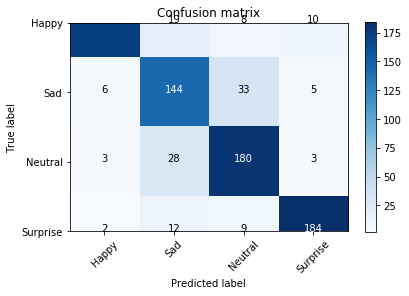

In [ ]:
import itertools
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

y_true = np.load('./truey.npy')
y_pred = np.load('./predy.npy')
cm = confusion_matrix(y_true, y_pred)
labels = [ 'Happy','Sad','Neutral', 'Surprise']
title='Confusion matrix'
print(cm)

"""emotions={0:'neutral', 1:'happiness', 2:'surprise', 3:'sadness',
       4:'anger', 5:'disgust', 6:'fear', 7:'contempt'"""

plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title(title)
plt.colorbar()
tick_marks = np.arange(len(labels))
plt.xticks(tick_marks, labels, rotation=45)
plt.yticks(tick_marks, labels)
fmt = 'd'
thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(j, i, format(cm[i, j], fmt),
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black")

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.tight_layout()
plt.show()

**Testing with random downloaded images in drive**

Loaded model from disk
Image Loaded
Emotion: Surprise


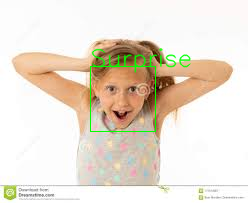

-1

In [ ]:
#from __future__ import division
#from keras.models import Sequential
#from keras.layers import Dense
from keras.models import model_from_json
#import numpy
#import os
#import numpy as np
import cv2
from google.colab.patches import cv2_imshow
#import glob

#loading the model
json_file = open('/content/drive/My Drive/hsnsfergaus.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("/content/drive/My Drive/hsnsfergaus.h5")
print("Loaded model from disk")

#setting image resizing parameters
WIDTH = 48
HEIGHT = 48
x=None
y=None
labels = [ 'Happy','Sad','Neutral', 'Surprise']



#loading image
full_size_image = cv2.imread('/content/drive/My Drive/surprise2.jpeg')
print("Image Loaded")
gray=cv2.cvtColor(full_size_image,cv2.COLOR_BGR2GRAY)
face = cv2.CascadeClassifier('/content/drive/My Drive/haarcascade_frontalface_default.xml')
faces = face.detectMultiScale(gray, 1.2  , 5)

#detecting faces
for (x, y, w, h) in faces:
        roi_gray = gray[y:y + h, x:x + w]
        cropped_img = np.expand_dims(np.expand_dims(cv2.resize(roi_gray, (48, 48)), -1), 0)
        cv2.normalize(cropped_img, cropped_img, alpha=0, beta=1, norm_type=cv2.NORM_L2, dtype=cv2.CV_32F)
        cv2.rectangle(full_size_image, (x, y), (x + w, y + h), (0, 255, 0), 1)
        #predicting the emotion
        yhat= loaded_model.predict(cropped_img)
        cv2.putText(full_size_image, labels[int(np.argmax(yhat))], (x, y), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 1, cv2.LINE_AA)
        print("Emotion: "+labels[int(np.argmax(yhat))])
        #cv2_imshow(cropped_img)

cv2_imshow(full_size_image)
cv2.waitKey()



After iteration-1 of testing with custom images, it is observed that fear class is biased more!


Also, images that have faces oriented at different angles are not detected by the haarcascade filter probably.

ferarch1.json is the model trained over the fer+ dataset. It gave a training accuracy of 91%, validation accuracy of 79% and a test accuracy of 79%

Next time when a model is fine-tuned or trained with a new dataset or another architecture, save it under a different name.

**Testing through many images in a folder**

Loaded model from disk
Image Loaded
(1, 48, 48, 1)
[[0.5246061  0.29599687 0.14786352 0.03153353]]
Emotion: Happy


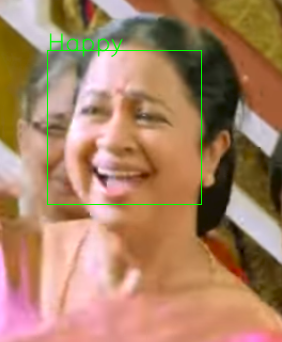

Image Loaded
(1, 48, 48, 1)
[[0.02627995 0.43813115 0.15368696 0.38190186]]
Emotion: Failed to detect emotion


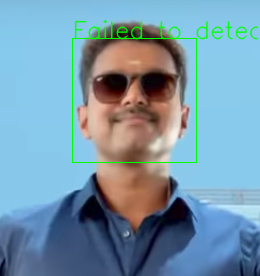

Image Loaded
(1, 48, 48, 1)
[[1.8777772e-08 4.8896822e-05 9.9994683e-01 4.2868578e-06]]
Emotion: Neutral
(1, 48, 48, 1)
[[3.149662e-06 6.890539e-04 1.419086e-06 9.993063e-01]]
Emotion: Surprise


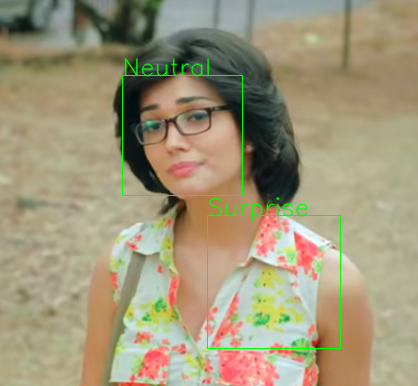

Image Loaded
(1, 48, 48, 1)
[[1.0921870e-05 1.5065441e-03 9.9807858e-01 4.0395590e-04]]
Emotion: Neutral


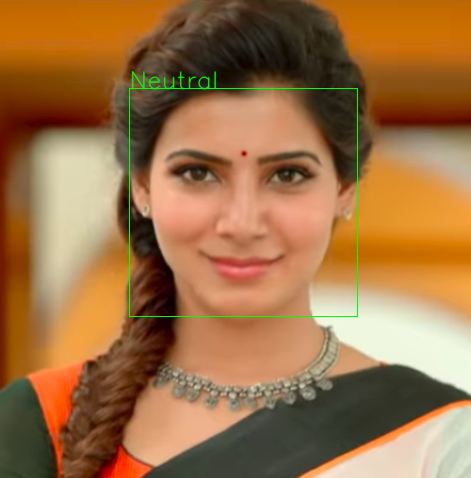

Image Loaded
(1, 48, 48, 1)
[[0.0307903 0.2743781 0.1380164 0.5568152]]
Emotion: Surprise
(1, 48, 48, 1)
[[3.4270631e-04 9.8123644e-03 1.5119203e-04 9.8969382e-01]]
Emotion: Surprise


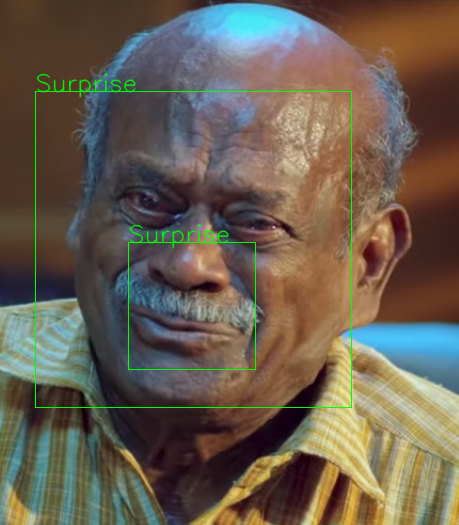

Image Loaded
(1, 48, 48, 1)
[[0.01171482 0.6992677  0.03167327 0.25734425]]
Emotion: Sad


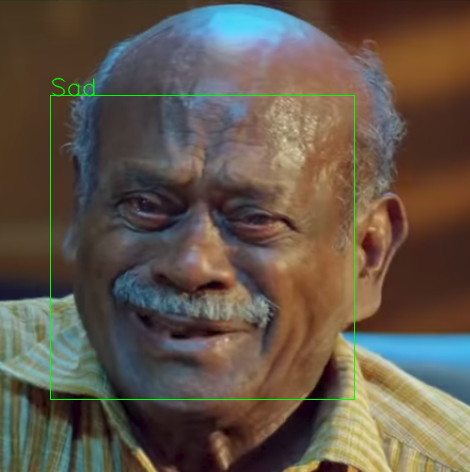

Image Loaded


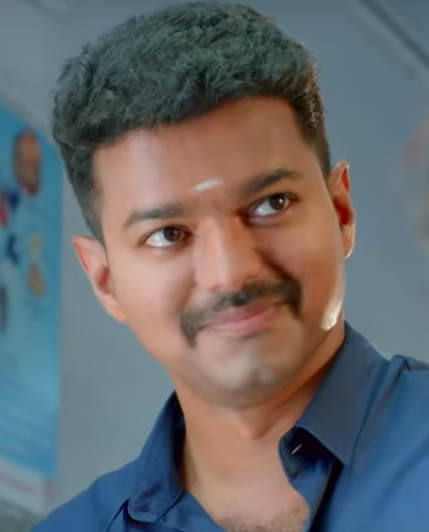

Image Loaded
(1, 48, 48, 1)
[[4.1758060e-12 2.1819211e-07 3.8068819e-12 9.9999976e-01]]
Emotion: Surprise


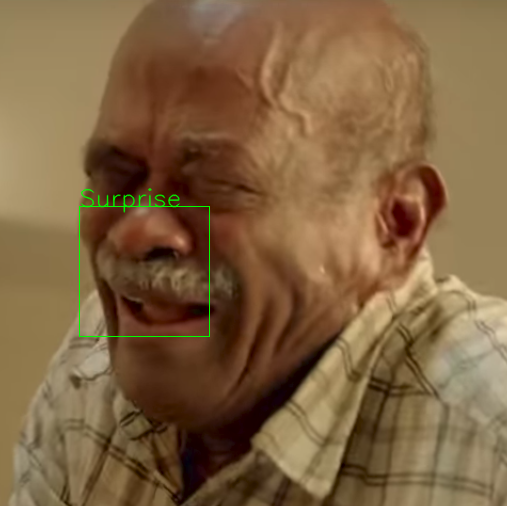

Image Loaded
(1, 48, 48, 1)
[[0.00186634 0.02999056 0.0015386  0.9666044 ]]
Emotion: Surprise


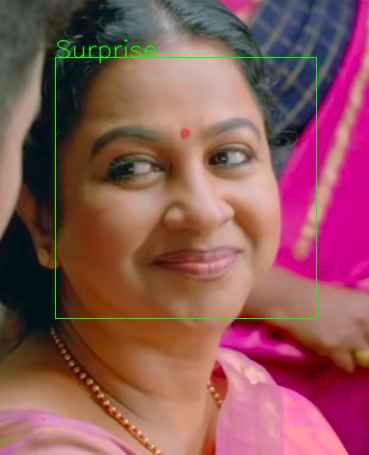

Image Loaded
(1, 48, 48, 1)
[[0.39562994 0.27582088 0.26081207 0.06773711]]
Emotion: Failed to detect emotion


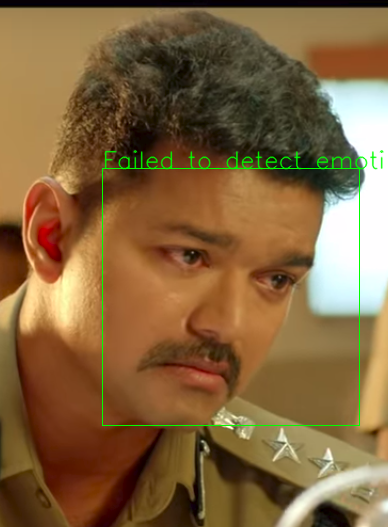

Image Loaded
(1, 48, 48, 1)
[[9.8609018e-01 5.4471716e-03 8.4109530e-03 5.1633506e-05]]
Emotion: Happy


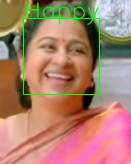

Image Loaded
(1, 48, 48, 1)
[[0.02351478 0.10702186 0.04029251 0.8291709 ]]
Emotion: Surprise


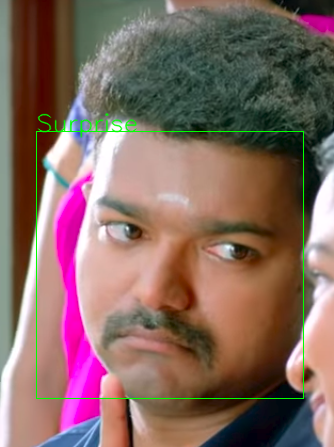

Image Loaded
(1, 48, 48, 1)
[[0.02862038 0.27825665 0.03674195 0.6563811 ]]
Emotion: Surprise


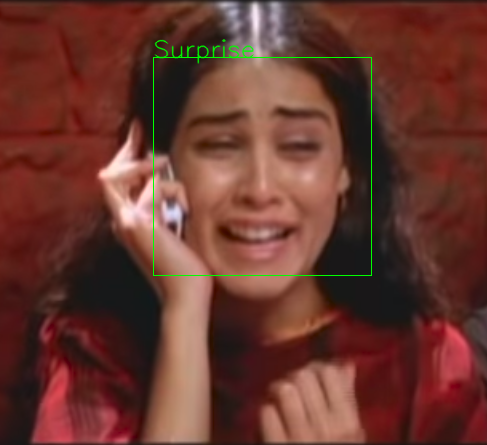

Image Loaded
(1, 48, 48, 1)
[[0.02854899 0.40849409 0.01760028 0.5453567 ]]
Emotion: Surprise


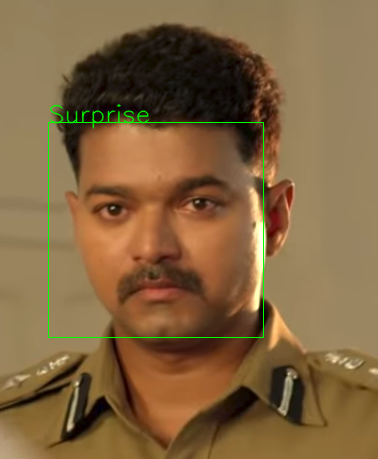

Image Loaded
(1, 48, 48, 1)
[[4.8774966e-24 3.6129113e-14 1.1395035e-22 1.0000000e+00]]
Emotion: Surprise


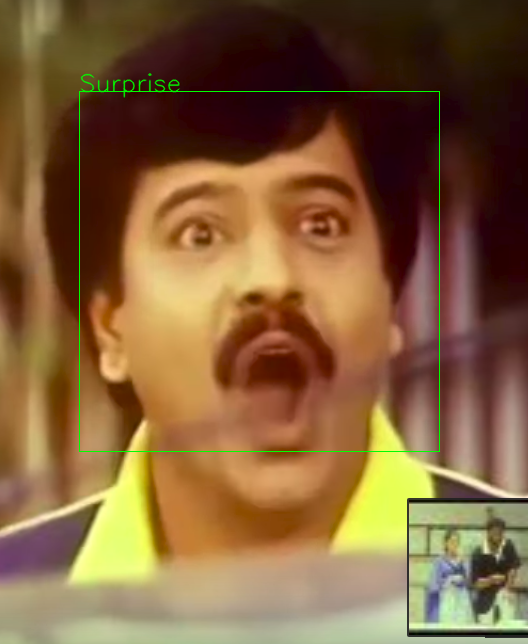

Image Loaded
(1, 48, 48, 1)
[[1.9061978e-16 7.1558653e-10 5.2162692e-16 1.0000000e+00]]
Emotion: Surprise


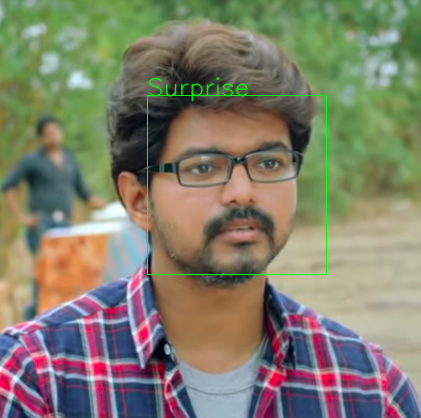

Image Loaded
(1, 48, 48, 1)
[[0.02010054 0.12586626 0.01769996 0.83633333]]
Emotion: Surprise


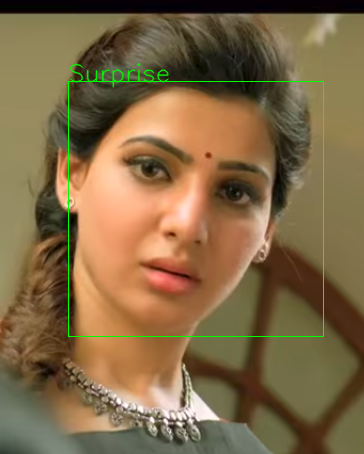

Image Loaded


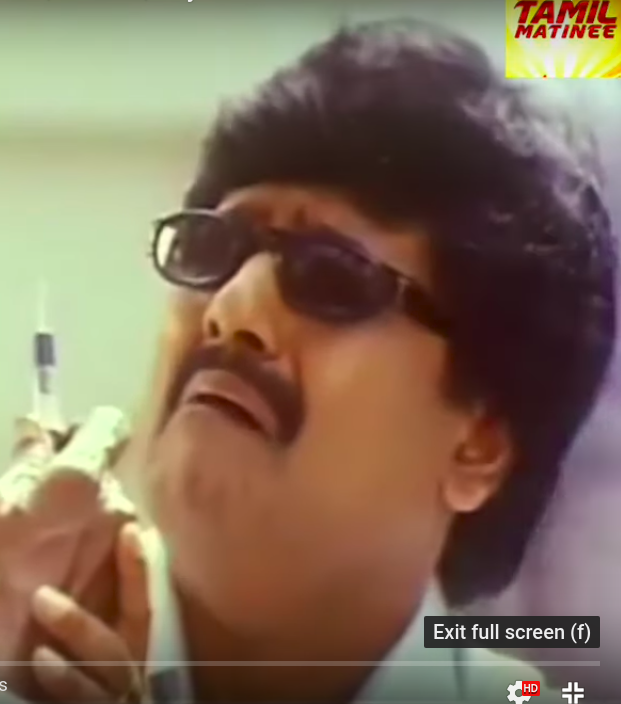

Image Loaded
(1, 48, 48, 1)
[[3.9580359e-37 2.2118299e-21 4.7203463e-33 1.0000000e+00]]
Emotion: Surprise


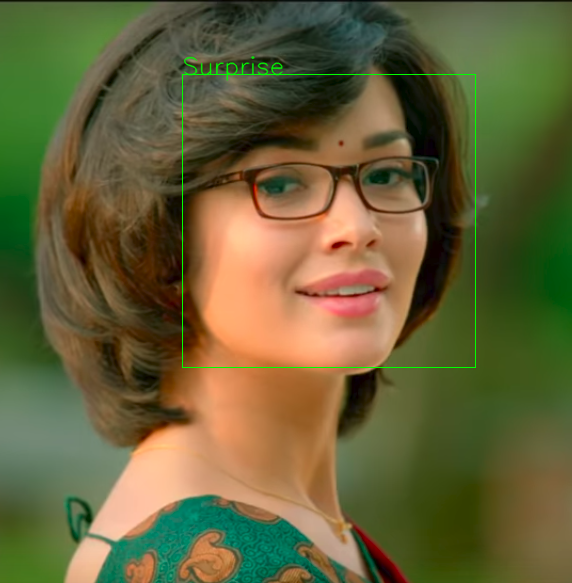

Image Loaded
(1, 48, 48, 1)
[[0.02718616 0.42088604 0.0311487  0.52077913]]
Emotion: Surprise


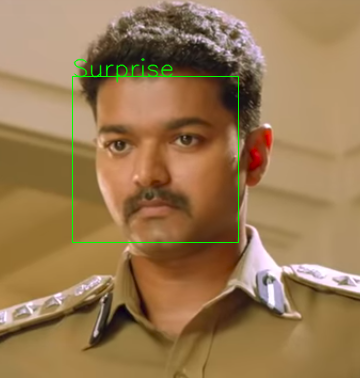

Image Loaded
(1, 48, 48, 1)
[[0.03900027 0.44619516 0.1984695  0.31633514]]
Emotion: Failed to detect emotion


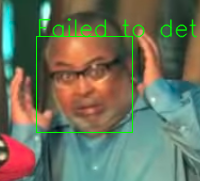

Image Loaded
(1, 48, 48, 1)
[[0.12598652 0.64890754 0.17692097 0.04818494]]
Emotion: Sad


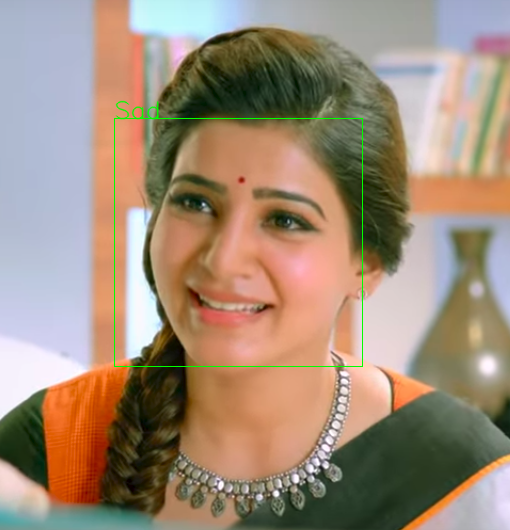

Image Loaded
(1, 48, 48, 1)
[[3.8717235e-06 7.3189952e-04 1.6221006e-06 9.9926251e-01]]
Emotion: Surprise


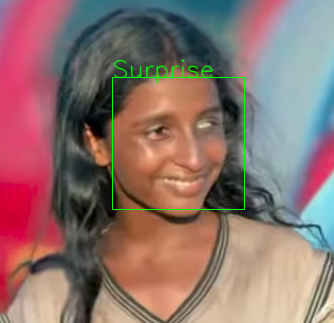

Image Loaded
(1, 48, 48, 1)
[[0.02752843 0.19160746 0.7184926  0.06237152]]
Emotion: Neutral


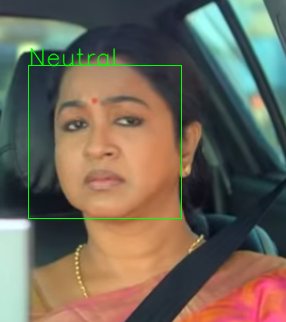

Image Loaded
(1, 48, 48, 1)
[[8.3714391e-35 4.1005091e-20 2.7424128e-31 1.0000000e+00]]
Emotion: Surprise


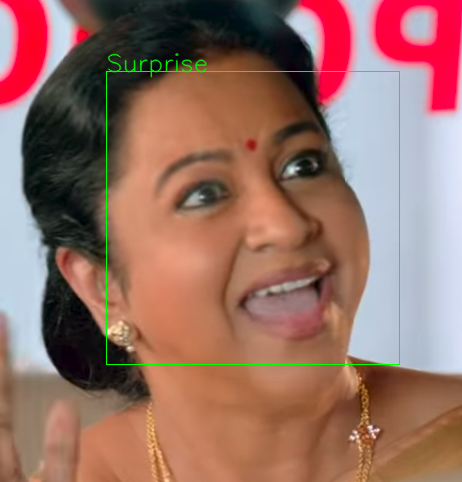

Image Loaded
(1, 48, 48, 1)
[[2.9181572e-07 1.1725101e-04 7.8303600e-08 9.9988234e-01]]
Emotion: Surprise


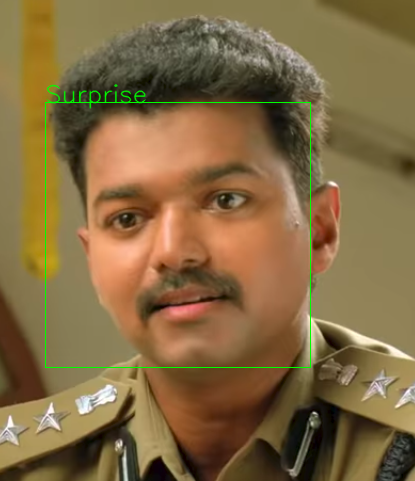

Image Loaded
(1, 48, 48, 1)
[[0.03842128 0.48908922 0.140333   0.33215642]]
Emotion: Failed to detect emotion


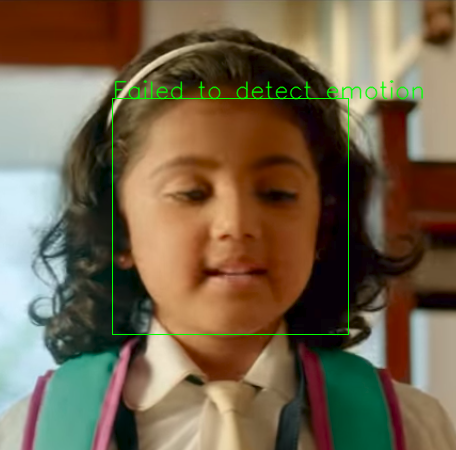

In [ ]:
#from __future__ import division
#from keras.models import Sequential
#from keras.layers import Dense
from keras.models import model_from_json
#import numpy
#import os
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import glob
import csv

#loading the model
json_file = open('/content/drive/My Drive/hsnsfergauslayer.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("/content/drive/My Drive/hsnsfergauslayer.h5")
print("Loaded model from disk")

#setting image resizing parameters
WIDTH = 48
HEIGHT = 48
x=None
y=None
labels = [ 'Happy','Sad','Neutral', 'Surprise']

row= ['image name', 'face detected', 'emotion detected', 'emotion predicted']

with open('/content/drive/My Drive/mvitest4.csv', 'w') as writeFile:
        writer = csv.writer(writeFile)
        writer.writerow(row)  

path = "/content/drive/My Drive/moviepics/*.png"
for file in glob.glob(path):
  #print(file)
  #a= cv2.imread(file)
  #print(a)
  f = False
  e = False
  lab = "None"
  

  #loading image
  full_size_image = cv2.imread(file)
  print("Image Loaded")
  gray=cv2.cvtColor(full_size_image,cv2.COLOR_BGR2GRAY)
  face = cv2.CascadeClassifier('/content/drive/My Drive/haarcascade_frontalface_default.xml')
  faces = face.detectMultiScale(gray, 1.1  , 5)

  #detecting faces
  for (x, y, w, h) in faces:
    f = True
    roi_gray = gray[y:y + h, x:x + w]
    cropped_img = np.expand_dims(np.expand_dims(cv2.resize(roi_gray, (48, 48)), -1), 0)
    print(cropped_img.shape)
    cv2.normalize(cropped_img, cropped_img, alpha=0, beta=1, norm_type=cv2.NORM_L2, dtype=cv2.CV_32F)
    cv2.rectangle(full_size_image, (x, y), (x + w, y + h), (0, 255, 0), 1)
    #predicting the emotion
    yhat= loaded_model.predict(cropped_img)
    print(yhat)
    if np.max(yhat)>0.5:
      lab = labels[int(np.argmax(yhat))]
    else:
      lab = "Failed to detect emotion"
    if yhat.any():
      e = True
    cv2.putText(full_size_image, lab, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 1, cv2.LINE_AA)
    print("Emotion: "+lab)
    #cv2_imshow(cropped_img)

  with open('/content/drive/My Drive/mvitest4.csv', 'a') as writeFile:
    writer = csv.writer(writeFile)
    writer.writerow([file, f, e, lab])

  cv2_imshow(full_size_image)
  cv2.waitKey()

**Copy of the above code, but face detection happens with thresholding**

Loaded model from disk
/content/drive/My Drive/realtime/sad333.png
Image Loaded


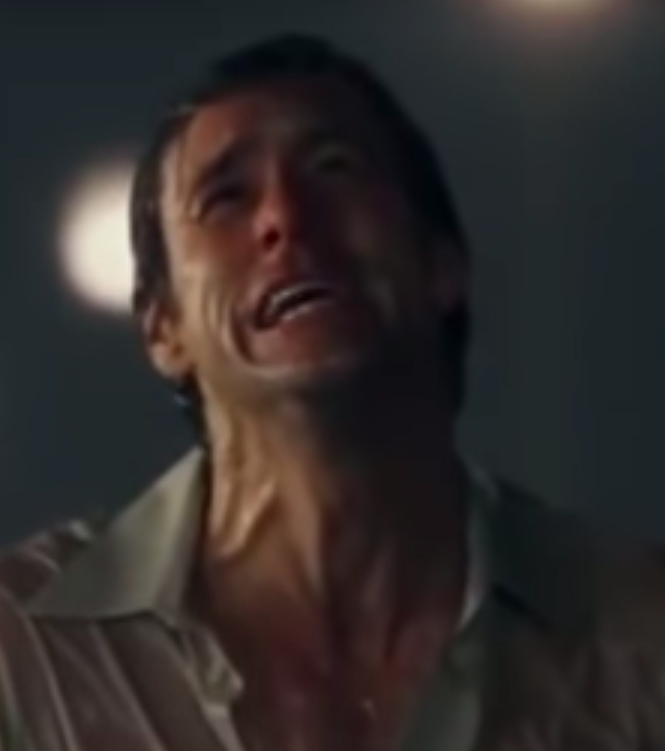

/content/drive/My Drive/realtime/beautiful-young-woman-eating-asian-sushi-using_cg3p03866260c_th.jpg
Image Loaded
detected face is less than threshold composition
face detected


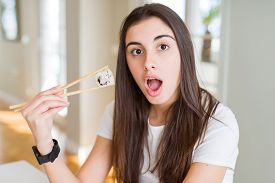

/content/drive/My Drive/realtime/neutral1111.png
Image Loaded
[[0.01592217 0.08443503 0.01247206 0.88717073]]
Emotion: Surprise
1
face detected


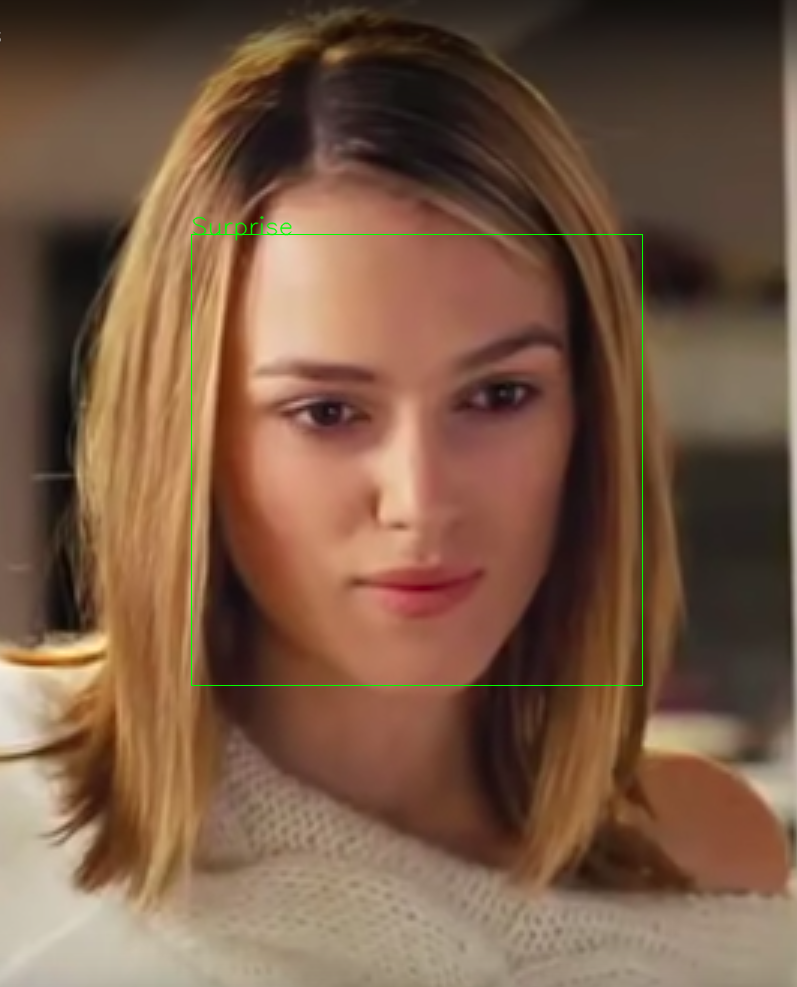

/content/drive/My Drive/realtime/happy11.png
Image Loaded


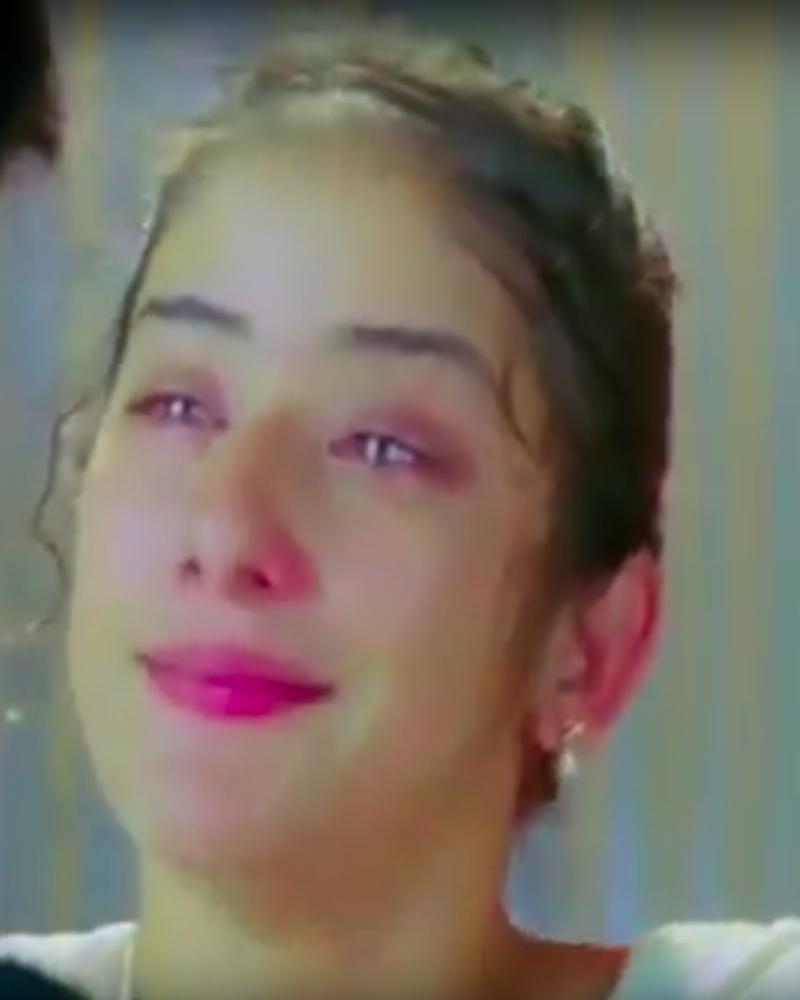

/content/drive/My Drive/realtime/neutral.png
Image Loaded
[[6.8140802e-15 7.0717179e-09 9.1496275e-14 1.0000000e+00]]
Emotion: Surprise
2
face detected


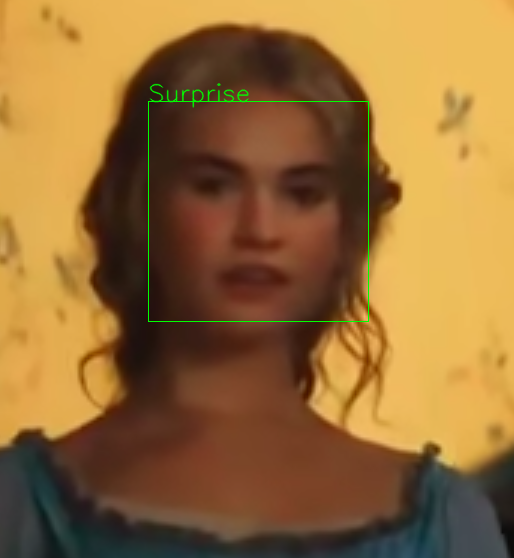

/content/drive/My Drive/realtime/happy2222.png
Image Loaded
[[0.00762944 0.05206751 0.00508151 0.93522155]]
Emotion: Surprise
3
detected face is less than threshold composition
face detected


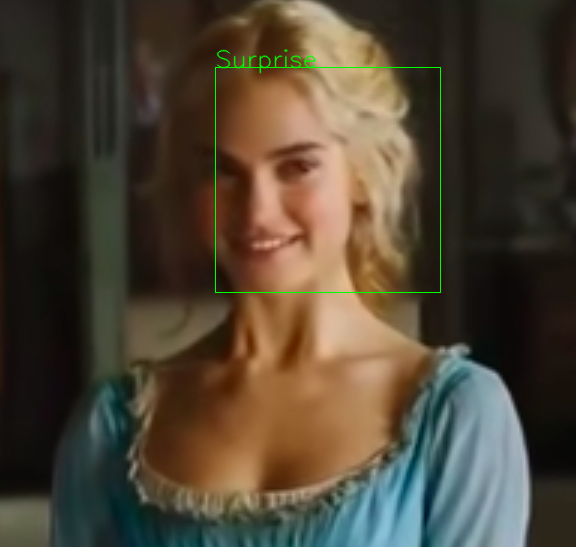

/content/drive/My Drive/realtime/surprise5555.png
Image Loaded
[[2.3313255e-12 1.3832613e-07 1.4195437e-12 9.9999988e-01]]
Emotion: Surprise
4
face detected


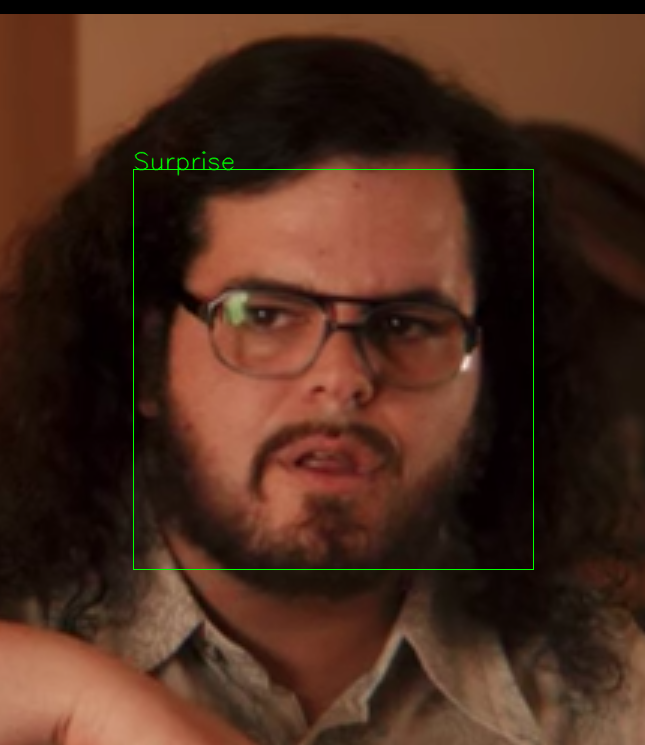

/content/drive/My Drive/realtime/surprise444.png
Image Loaded


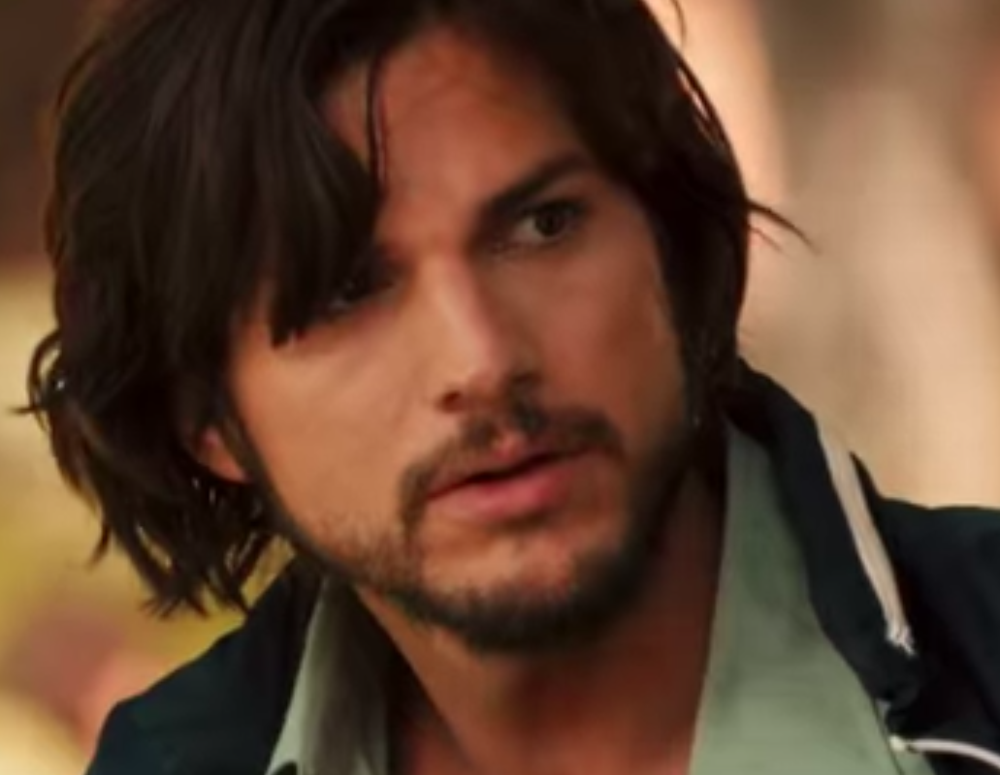

/content/drive/My Drive/realtime/happy.png
Image Loaded


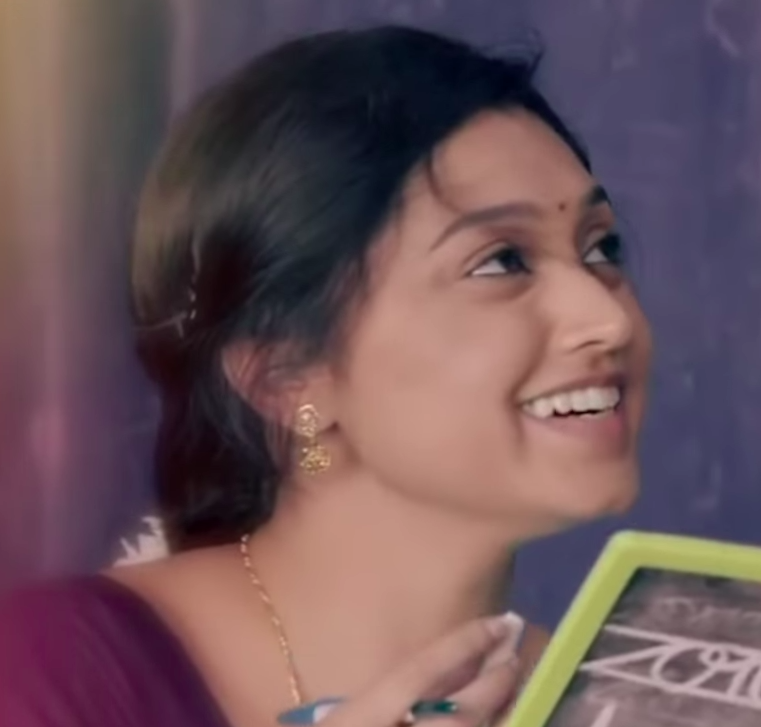

/content/drive/My Drive/realtime/sad.png
Image Loaded
[[4.8277760e-10 3.1603622e-06 3.3472741e-10 9.9999678e-01]]
Emotion: Surprise
5
face detected


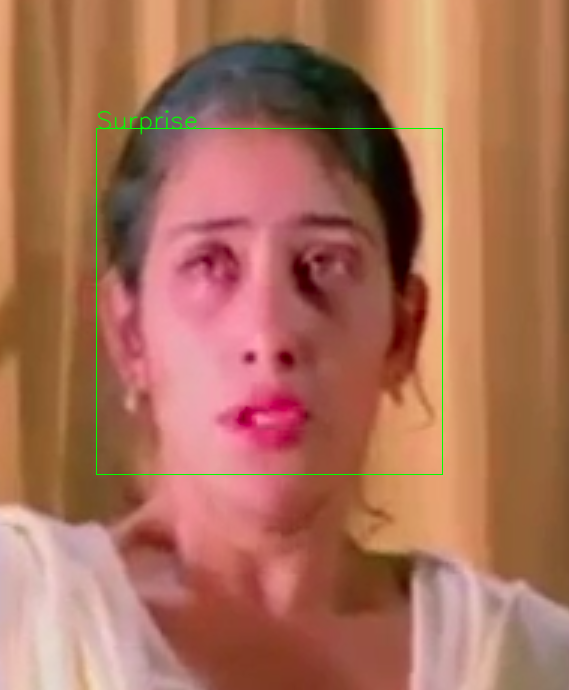

/content/drive/My Drive/realtime/baby_surprise.jpg
Image Loaded
[[0. 0. 0. 1.]]
Emotion: Surprise
6
face detected


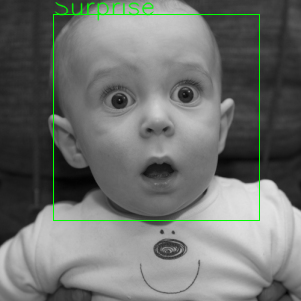

/content/drive/My Drive/realtime/surpose1).jpg
Image Loaded
[[1.3030096e-12 3.1554695e-08 4.5107117e-14 1.0000000e+00]]
Emotion: Surprise
7
face detected


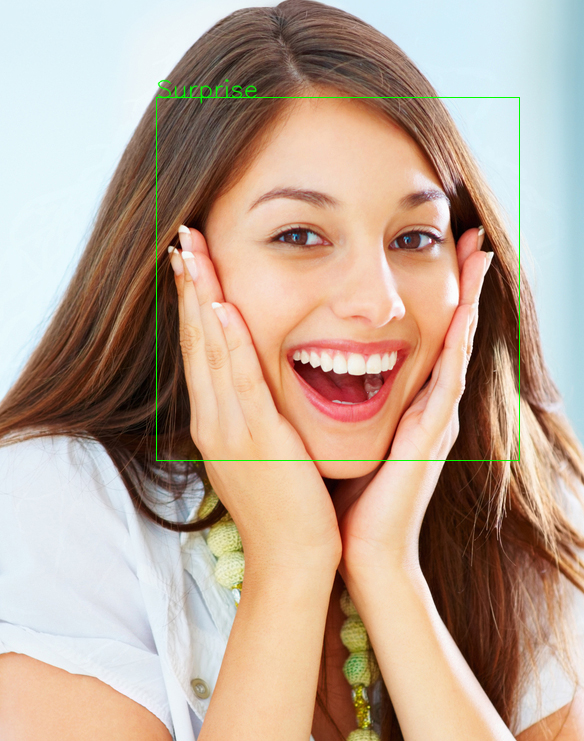

/content/drive/My Drive/realtime/surprise222.png
Image Loaded
[[7.4097636e-14 2.1811777e-08 1.5174992e-13 1.0000000e+00]]
Emotion: Surprise
8
face detected


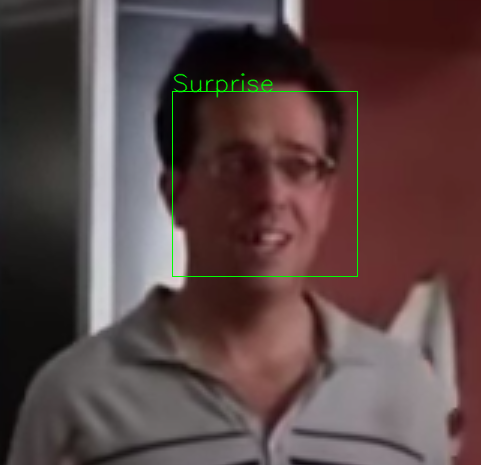

/content/drive/My Drive/realtime/happy1.png
Image Loaded


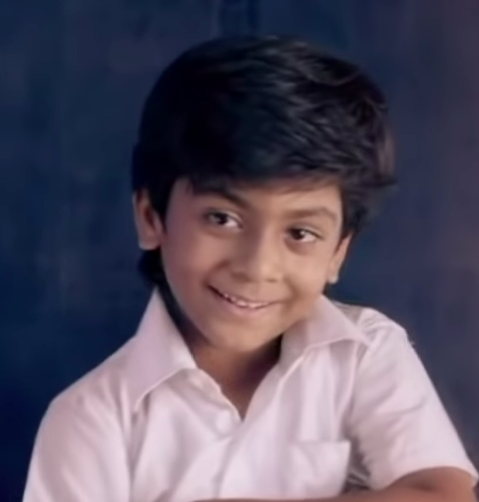

/content/drive/My Drive/realtime/surprise.png
Image Loaded
[[3.1614255e-07 1.3029676e-04 1.1442174e-07 9.9986923e-01]]
Emotion: Surprise
9
face detected


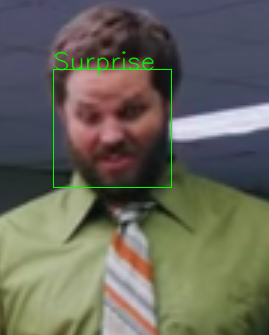

/content/drive/My Drive/realtime/surprise1111.png
Image Loaded
[[0.22144459 0.2963277  0.23640212 0.24582551]]
Emotion: Failed to detect emotion
10
face detected


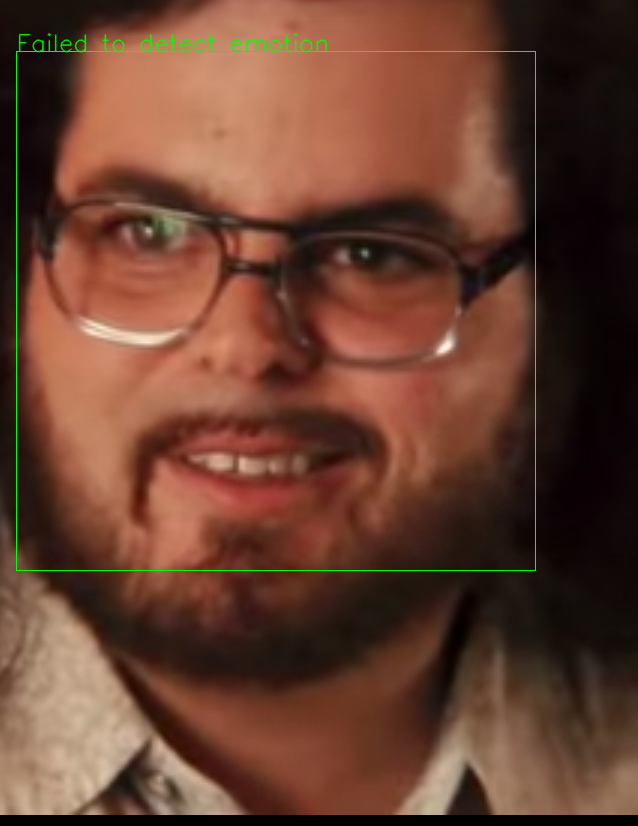

/content/drive/My Drive/realtime/sad face.png
Image Loaded
[[0.00801006 0.8379108  0.01979215 0.1342871 ]]
Emotion: Sad
11
face detected


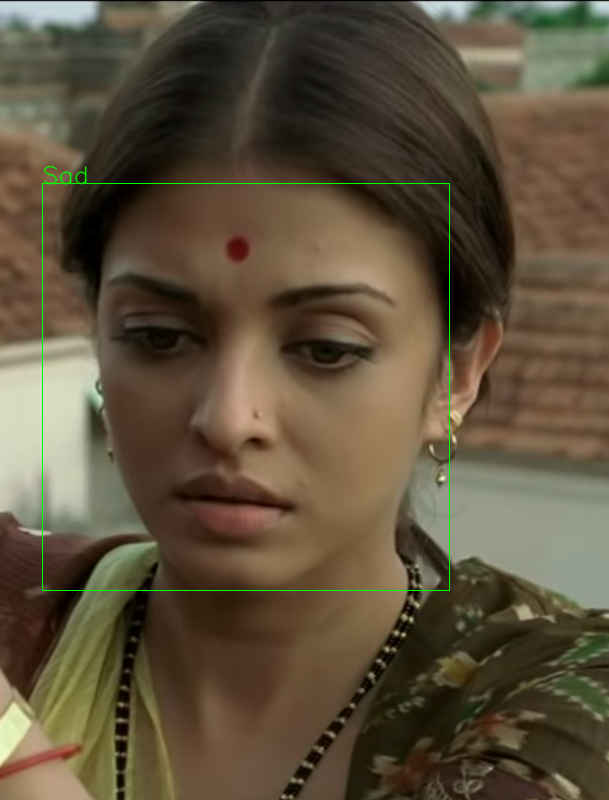

/content/drive/My Drive/realtime/surpirise 333.png
Image Loaded
detected face is less than threshold composition
[[0.0000000e+00 1.0742379e-26 0.0000000e+00 1.0000000e+00]]
Emotion: Surprise
12
face detected


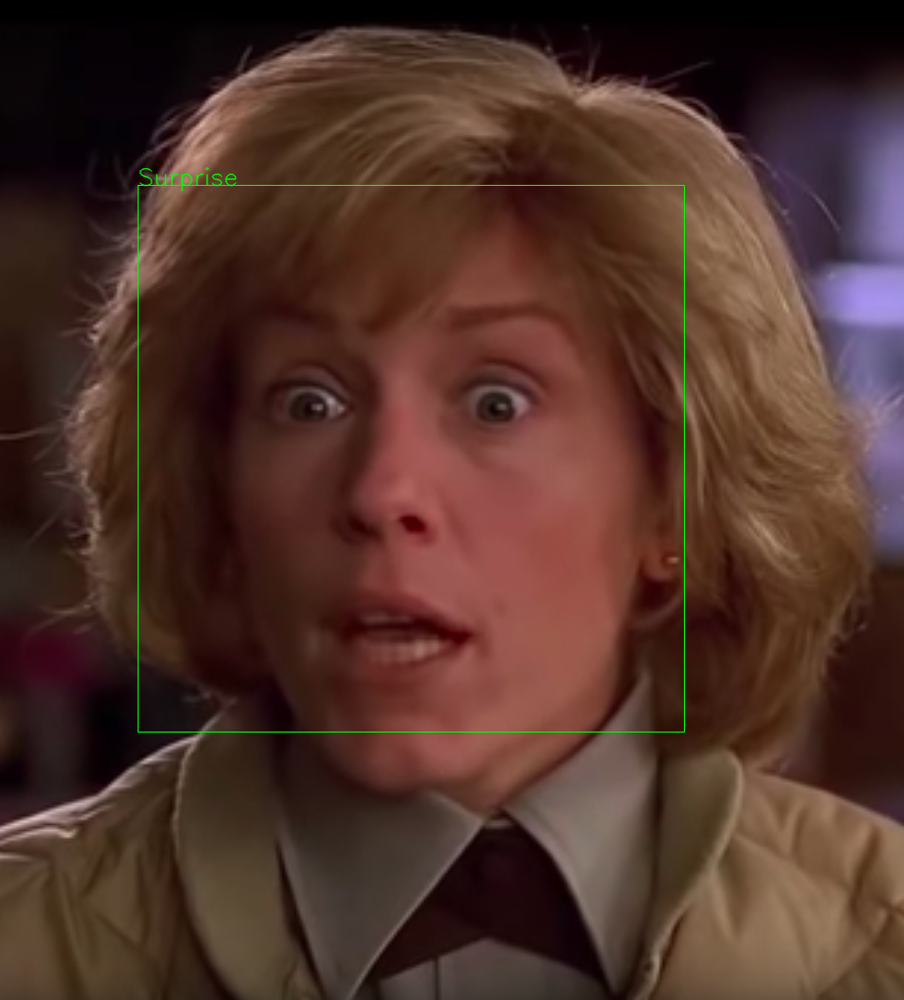

/content/drive/My Drive/realtime/sad1.png
Image Loaded


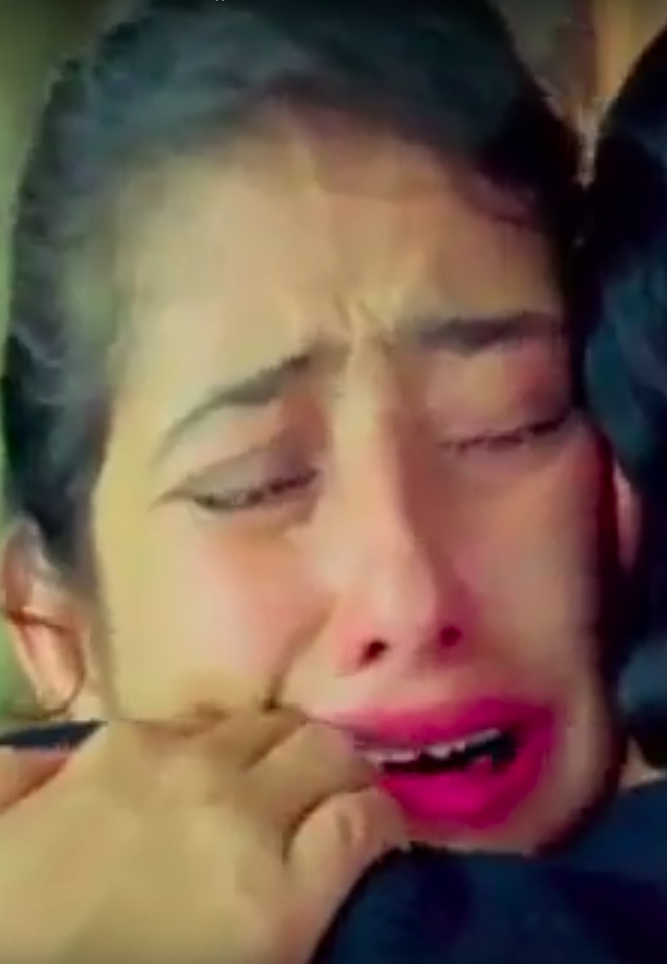

/content/drive/My Drive/realtime/happy111.png
Image Loaded
[[1.0000000e+00 6.1872675e-13 7.7722195e-12 1.2294730e-21]]
Emotion: Happy
13
face detected


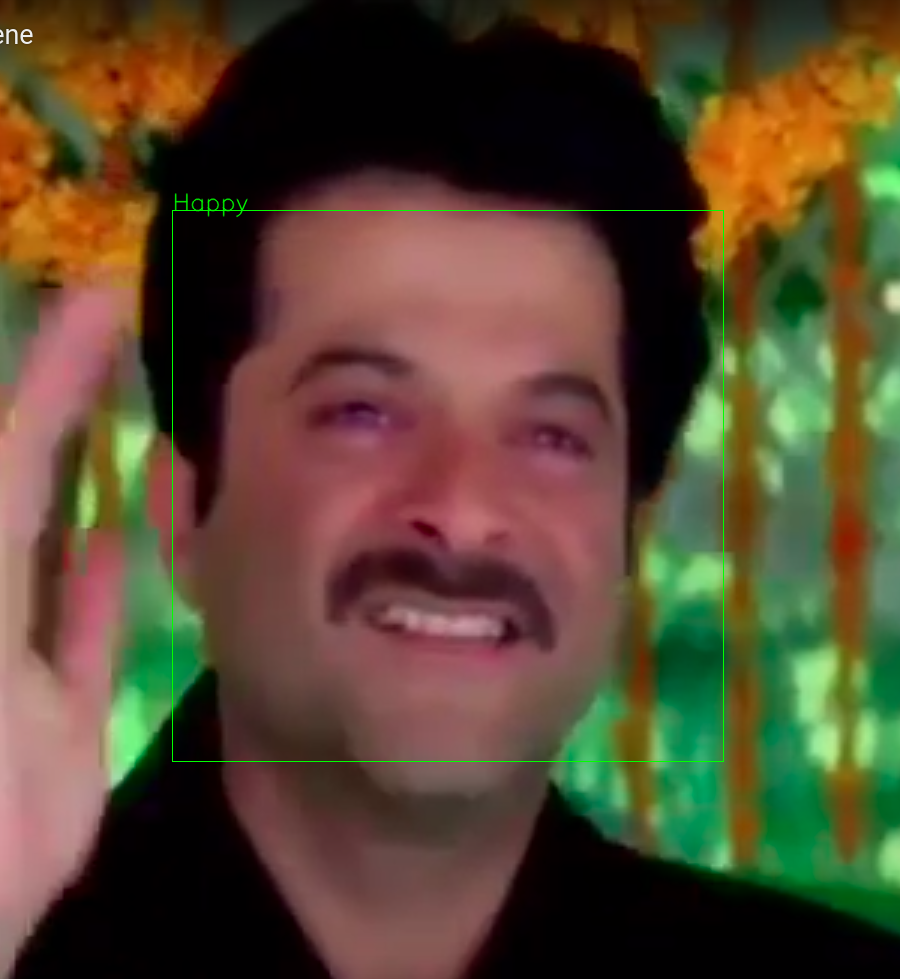

/content/drive/My Drive/realtime/happy555.png
Image Loaded
[[9.9874157e-01 5.9815089e-04 6.5974542e-04 5.5828201e-07]]
Emotion: Happy
14
face detected


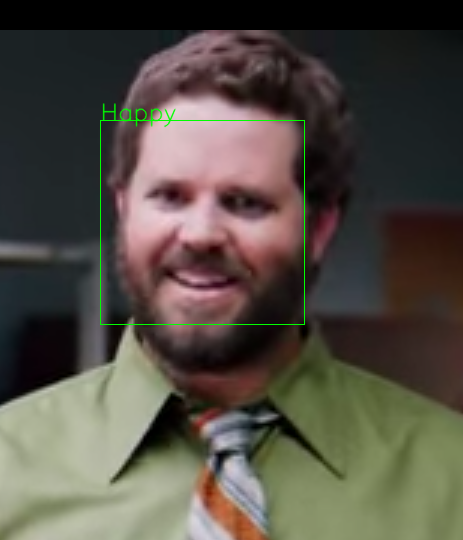

/content/drive/My Drive/realtime/happy3444.png
Image Loaded
[[0.03461001 0.41172808 0.0743169  0.47934508]]
Emotion: Failed to detect emotion
15
detected face is less than threshold composition
face detected


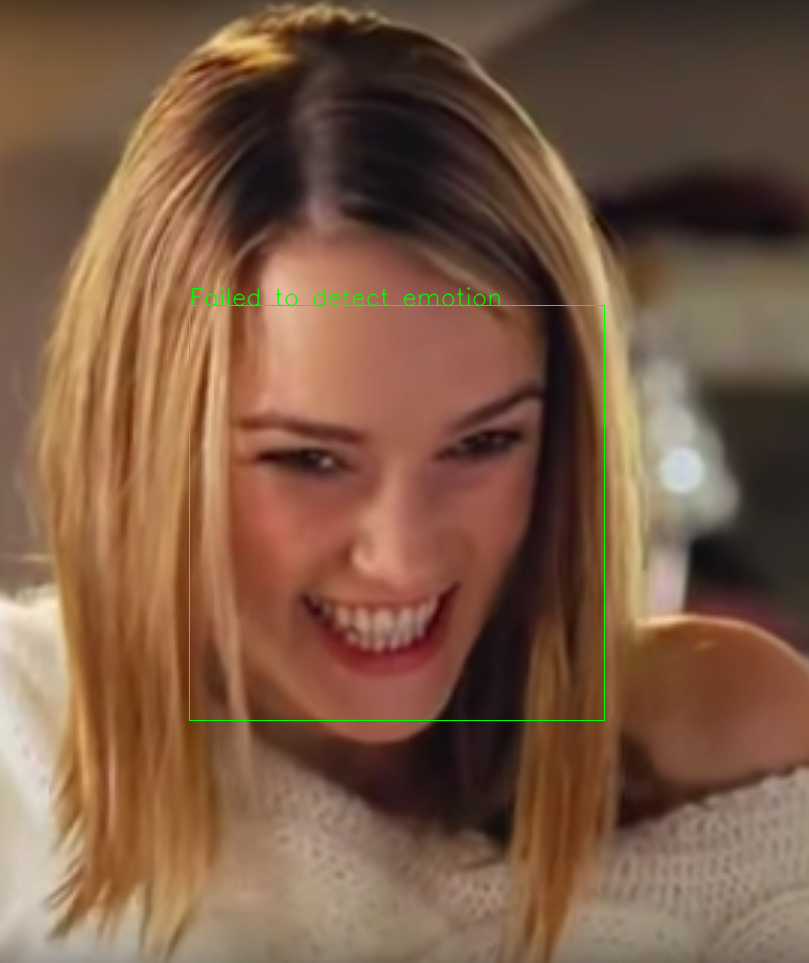

/content/drive/My Drive/realtime/surprise33333.png
Image Loaded
[[7.6941930e-04 9.8460788e-01 1.3903323e-02 7.1935967e-04]]
Emotion: Sad
16
face detected


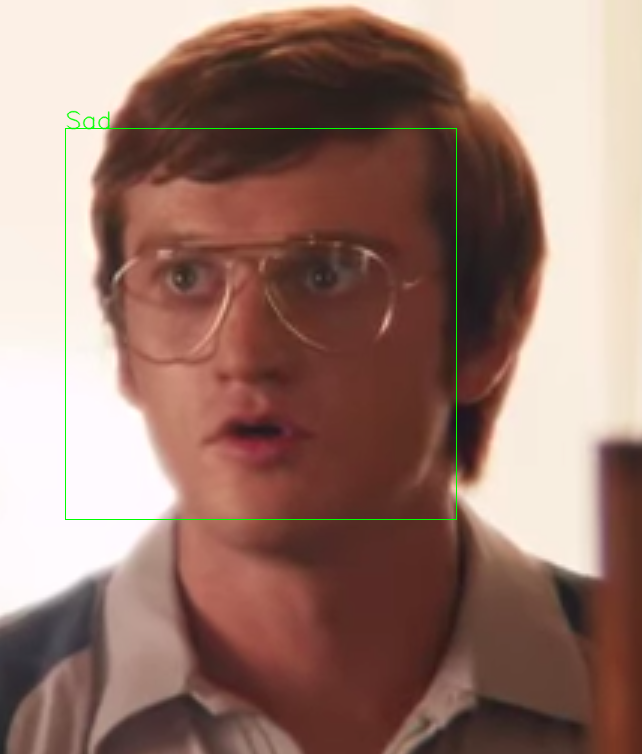

/content/drive/My Drive/realtime/neutral888.png
Image Loaded
[[3.3227948e-08 3.5382123e-05 1.3983319e-08 9.9996459e-01]]
Emotion: Surprise
17
face detected


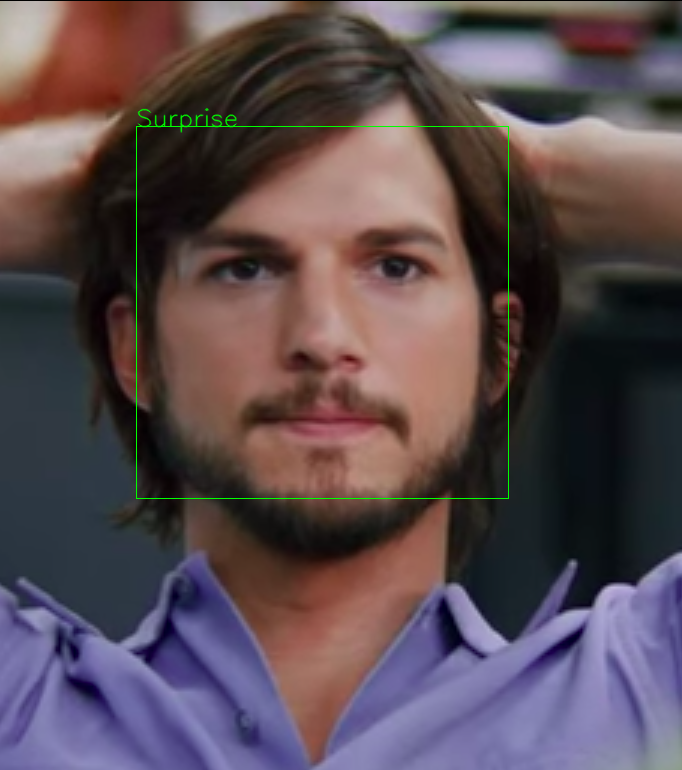

no.of images:17


In [ ]:
#from __future__ import division
#from keras.models import Sequential
#from keras.layers import Dense
from keras.models import model_from_json
#import numpy
#import os
#import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import glob
import csv

#loading the model
json_file = open('/content/drive/My Drive/hsnsfergauslayer.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("/content/drive/My Drive/hsnsfergauslayer.h5")
print("Loaded model from disk")

#setting image resizing parameters
WIDTH = 48
HEIGHT = 48
x=None
y=None
labels = [ 'Happy','Sad','Neutral', 'Surprise']
i=0

row= ['image name', 'face detected', 'emotion detected', 'emotion predicted']

# with open('/content/drive/My Drive/mvitest4.csv', 'w') as writeFile:
#     writer = csv.writer(writeFile)
#     writer.writerow(row)  

path = "/content/drive/My Drive/realtime/*"
for file in glob.glob(path):
    try:
        #print(file)
        #a= cv2.imread(file)
        #print(a)
        f = False
        e = False
        lab = "None"
        print(file)
        


        #loading image
        full_size_image = cv2.imread(file)
        print("Image Loaded")
        gray=cv2.cvtColor(full_size_image,cv2.COLOR_BGR2GRAY)
        face = cv2.CascadeClassifier('/content/drive/My Drive/haarcascade_frontalface_default.xml')
        faces = face.detectMultiScale(gray, 1.2, 5, minSize=(30,30),flags=cv2.CASCADE_SCALE_IMAGE )

        #detecting faces
        for (x, y, w, h) in faces:
            f = True
            #roi_gray = gray[y-10 : y+h+10 , x-10 : x+w+10]
            #cropped_img = np.expand_dims(np.expand_dims(cv2.resize(roi_gray, (48, 48)), -1), 0)
            #cv2.normalize(cropped_img, cropped_img, alpha=0, beta=1, norm_type=cv2.NORM_L2, dtype=cv2.CV_32F)
            #cv2.rectangle(full_size_image, (x, y), (x + w, y + h), (0, 255, 0), 1)
            
            ### Cropping the face from the image ###
            face = full_size_image[y: y+h , x : x+w]
            facen = cv2.cvtColor(face,cv2.COLOR_BGR2RGB)
            
            ###Ratio of areas of orig img and cropped img###
            area_orig = full_size_image.shape[0]*full_size_image.shape[1]  
            area_crop = w*h
            ratio = area_crop/area_orig
            
            ### Regulating the quality of detected faces inorder to avoid noise by multiple detection in the same  image ###
            if ratio>0.15:
                #cv2_imshow(face)
                roi_per_gray=cv2.cvtColor(facen,cv2.COLOR_RGB2GRAY)  #Convert face to gray
                cropped_img = np.expand_dims(np.expand_dims(cv2.resize(roi_per_gray, (48, 48)), -1), 0)
                cv2.normalize(cropped_img, cropped_img, alpha=0, beta=1, norm_type=cv2.NORM_L2, dtype=cv2.CV_32F)
                cv2.rectangle(full_size_image, (x, y), (x + w, y + h), (0, 255, 0), 1)
                #predicting the emotion
                yhat= loaded_model.predict(cropped_img)
                print(yhat)
                if np.max(yhat)>0.5:
                  lab = labels[int(np.argmax(yhat))]
                else:
                  lab = "Failed to detect emotion"
                if yhat.any():
                  e = True
                cv2.putText(full_size_image, lab, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 1, cv2.LINE_AA)
                print("Emotion: "+lab)
                i+=1
                print(i)
            else:
                print("detected face is less than threshold composition")
            
        if (f == True):
            print("face detected")
    except AttributeError: 
        count +=1
        print("no of problematic images:"+ str(count))
        pass

    # with open('/content/drive/My Drive/mvitest4.csv', 'a') as writeFile:
    #     writer = csv.writer(writeFile)
    #     writer.writerow([file, f, e, lab])

    cv2_imshow(full_size_image)
    cv2.waitKey()

print("no.of images:"+str(i))

Three iterations of face detection were performed. 

(i) scale factor = 1.3
minneighbor = 10
image is read in bgr format but rgb to gray cnvert color was used - 11/31 images failed in face detection [ytbtest.csv]

(ii) same parameters were used but bgr to gray convert color was used - 9/31 images failed in face detection [ytbtest1.csv]

(iii) bgr to gray was used. 
scale factor = 1.2
minneighbor = 5
for this conditions, 4/31 images failed in face detection. But in this iteration, the predicted emotions were more accurate.

**predicting images without face detection**

Loaded model from disk
Image Loaded
[[[ 86 126 144]
  [ 81 121 137]
  [ 73 113 129]
  ...
  [ 93 133 153]
  [ 94 134 154]
  [ 94 134 154]]

 [[ 85 125 142]
  [ 77 118 134]
  [ 68 108 124]
  ...
  [ 93 133 153]
  [ 94 134 154]
  [ 94 134 154]]

 [[ 83 125 141]
  [ 75 115 131]
  [ 65 105 121]
  ...
  [ 93 133 153]
  [ 94 134 154]
  [ 94 134 154]]

 ...

 [[ 93 135 155]
  [ 93 135 155]
  [ 93 135 155]
  ...
  [ 99 146 189]
  [ 94 140 177]
  [ 90 135 166]]

 [[ 93 135 155]
  [ 93 135 155]
  [ 93 135 155]
  ...
  [ 98 147 193]
  [ 97 142 184]
  [ 95 139 175]]

 [[ 93 135 155]
  [ 93 135 155]
  [ 93 135 155]
  ...
  [ 95 142 190]
  [ 99 143 189]
  [ 97 141 180]]]


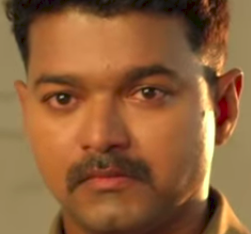

Image Loaded
[[[  0  32  72]
  [  0  31  71]
  [  4  29  70]
  ...
  [ 17  18  49]
  [ 17  18  50]
  [ 17  17  51]]

 [[  0  31  71]
  [  0  31  71]
  [  6  29  70]
  ...
  [ 18  20  50]
  [ 19  20  51]
  [ 19  18  53]]

 [[  0  31  71]
  [  0  31  71]
  [  4  28  70]
  ...
  [ 19  20  51]
  [ 19  19  52]
  [ 19  18  53]]

 ...

 [[179 236 252]
  [175 231 247]
  [169 224 241]
  ...
  [124 195 159]
  [124 195 158]
  [124 195 158]]

 [[166 218 233]
  [155 206 222]
  [143 193 210]
  ...
  [126 197 163]
  [125 197 163]
  [124 196 163]]

 [[138 186 201]
  [124 171 185]
  [111 157 172]
  ...
  [125 198 166]
  [125 197 166]
  [125 196 166]]]


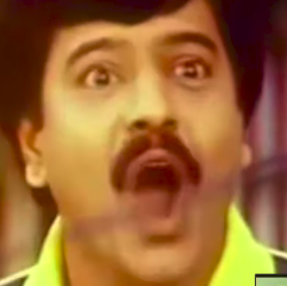

Image Loaded
[[[116  99 102]
  [116  99 102]
  [115 100 101]
  ...
  [ 30  27  75]
  [ 30  27  75]
  [ 30  27  76]]

 [[118 101 104]
  [118 101 104]
  [116 102 103]
  ...
  [ 31  27  76]
  [ 31  27  76]
  [ 31  26  77]]

 [[118 101 104]
  [118 101 105]
  [117 100 104]
  ...
  [ 31  26  77]
  [ 31  26  77]
  [ 31  26  77]]

 ...

 [[ 45  45  53]
  [ 37  36  44]
  [ 32  32  39]
  ...
  [ 52  47 112]
  [ 52  47 112]
  [ 52  47 112]]

 [[ 38  39  47]
  [ 32  30  39]
  [ 26  25  34]
  ...
  [ 52  47 112]
  [ 52  47 112]
  [ 52  47 112]]

 [[ 36  36  44]
  [ 30  29  38]
  [ 25  23  33]
  ...
  [ 52  47 111]
  [ 52  47 111]
  [ 52  47 111]]]


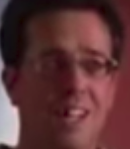

Image Loaded
[[[ 28  96 113]
  [ 32 100 117]
  [ 37 105 122]
  ...
  [ 10  77 134]
  [  7  78 133]
  [  0  76 133]]

 [[ 30  96 111]
  [ 34 101 117]
  [ 40 107 122]
  ...
  [ 16  76 137]
  [ 14  78 137]
  [ 12  76 137]]

 [[ 33  96 108]
  [ 36  99 113]
  [ 40 104 118]
  ...
  [ 20  76 140]
  [ 20  77 140]
  [ 20  78 142]]

 ...

 [[167 187 254]
  [169 188 255]
  [172 189 255]
  ...
  [ 24  83 101]
  [ 25  80  99]
  [ 28  82  99]]

 [[168 187 254]
  [170 187 255]
  [173 189 255]
  ...
  [ 24  81 101]
  [ 24  81  98]
  [ 25  80  99]]

 [[169 188 255]
  [171 189 255]
  [174 190 255]
  ...
  [ 25  84 104]
  [ 25  84 102]
  [ 24  82 102]]]


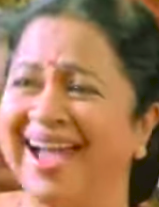

Image Loaded
[[[ 75  94 135]
  [ 63  82 120]
  [ 55  75 108]
  ...
  [ 45  20  26]
  [ 46  24  25]
  [ 46  29  25]]

 [[ 91 109 144]
  [ 85 103 135]
  [ 86 106 135]
  ...
  [ 66  34  42]
  [ 57  26  33]
  [ 51  21  27]]

 [[115 132 163]
  [112 130 160]
  [116 135 163]
  ...
  [126  97 101]
  [109  81  84]
  [ 95  63  69]]

 ...

 [[ 68  57  47]
  [ 68  57  47]
  [ 68  57  47]
  ...
  [ 43  39  31]
  [ 43  39  30]
  [ 42  38  30]]

 [[ 69  57  47]
  [ 69  56  47]
  [ 69  56  47]
  ...
  [ 43  39  30]
  [ 43  39  30]
  [ 43  39  30]]

 [[ 69  57  48]
  [ 69  57  48]
  [ 69  57  48]
  ...
  [ 43  39  30]
  [ 43  39  30]
  [ 43  39  30]]]


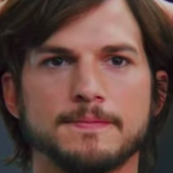

Image Loaded
[[[177 196 231]
  [130 147 190]
  [ 93 109 158]
  ...
  [ 34  48  88]
  [ 37  49  90]
  [ 42  52  94]]

 [[173 194 230]
  [127 146 188]
  [ 88 105 152]
  ...
  [ 35  47  85]
  [ 36  47  85]
  [ 40  50  89]]

 [[167 187 225]
  [118 136 179]
  [ 80  97 144]
  ...
  [ 37  47  82]
  [ 36  46  82]
  [ 39  49  84]]

 ...

 [[255 249 255]
  [255 249 255]
  [254 250 255]
  ...
  [173 191 222]
  [191 208 235]
  [203 220 242]]

 [[255 249 255]
  [254 249 255]
  [254 250 255]
  ...
  [156 174 211]
  [173 191 222]
  [187 205 231]]

 [[255 249 255]
  [254 250 255]
  [254 250 255]
  ...
  [141 160 202]
  [156 175 211]
  [171 189 219]]]


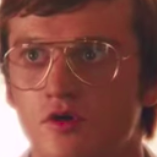

Image Loaded
[[[182  94 104]
  [186 105 112]
  [190 117 119]
  ...
  [ 40  56  28]
  [ 37  52  25]
  [ 37  52  25]]

 [[181  92 104]
  [184 102 108]
  [189 114 116]
  ...
  [ 38  54  24]
  [ 34  50  20]
  [ 40  56  26]]

 [[180  92 103]
  [182  99 107]
  [187 111 113]
  ...
  [ 46  63  32]
  [ 46  63  32]
  [ 56  74  43]]

 ...

 [[254   0 255]
  [254   0 255]
  [250   0 255]
  ...
  [ 24  20  14]
  [ 24  20  17]
  [ 24  20  19]]

 [[254   0 255]
  [254   0 255]
  [248   0 255]
  ...
  [ 22  18   0]
  [ 22  18   0]
  [ 22  17   0]]

 [[254   0 255]
  [254   0 255]
  [243   0 255]
  ...
  [ 22  18   0]
  [ 22  18   0]
  [ 22  18   0]]]


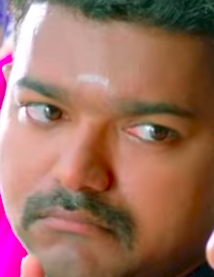

Image Loaded
[[[28 36 49]
  [34 42 55]
  [35 43 56]
  ...
  [36 49 78]
  [33 46 79]
  [26 41 77]]

 [[28 35 49]
  [34 42 55]
  [36 43 57]
  ...
  [37 48 74]
  [44 56 86]
  [37 51 84]]

 [[29 36 50]
  [35 41 55]
  [36 43 57]
  ...
  [37 46 70]
  [42 53 80]
  [37 50 80]]

 ...

 [[ 0 25 53]
  [ 2 27 57]
  [15 34 67]
  ...
  [64 82 94]
  [68 87 95]
  [68 90 93]]

 [[ 7 31 63]
  [ 0 26 60]
  [ 5 28 64]
  ...
  [65 85 95]
  [68 88 95]
  [68 91 94]]

 [[19 47 81]
  [ 6 35 71]
  [ 0 26 66]
  ...
  [66 88 96]
  [68 90 94]
  [68 92 94]]]


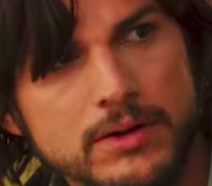

Image Loaded
[[[178 228 186]
  [177 227 185]
  [177 227 185]
  ...
  [127 112 128]
  [127 113 128]
  [127 115 126]]

 [[177 227 185]
  [177 227 185]
  [177 227 185]
  ...
  [127 112 128]
  [127 114 128]
  [130 117 129]]

 [[178 228 186]
  [178 228 186]
  [178 228 186]
  ...
  [127 112 129]
  [129 114 131]
  [133 118 135]]

 ...

 [[169 237 227]
  [182 250 234]
  [187 255 236]
  ...
  [ 38  29  54]
  [ 38  29  54]
  [ 39  30  55]]

 [[167 235 227]
  [178 246 232]
  [182 252 232]
  ...
  [ 38  30  54]
  [ 38  30  54]
  [ 39  31  54]]

 [[160 226 224]
  [173 240 229]
  [179 247 229]
  ...
  [ 38  32  53]
  [ 39  32  53]
  [ 39  32  53]]]


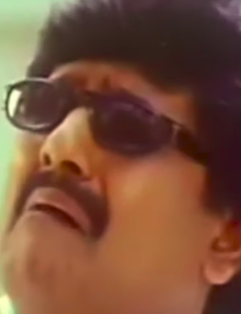

Image Loaded
[[[ 86 121  91]
  [ 87 120  91]
  [ 86 114  88]
  ...
  [ 29  12  16]
  [ 33  19  18]
  [ 39  25  21]]

 [[ 87 122  92]
  [ 88 121  91]
  [ 85 113  87]
  ...
  [ 26   8  14]
  [ 29  13  14]
  [ 32  16  16]]

 [[ 88 122  92]
  [ 86 118  89]
  [ 82 110  84]
  ...
  [ 24   1  14]
  [ 25   8  12]
  [ 27  11   9]]

 ...

 [[107 171 189]
  [106 170 188]
  [105 169 187]
  ...
  [ 44   0  18]
  [ 44   0  18]
  [ 46   0  20]]

 [[106 170 188]
  [106 170 188]
  [105 169 187]
  ...
  [ 43   0  20]
  [ 43   0  20]
  [ 43   0  19]]

 [[106 170 188]
  [106 170 188]
  [106 170 188]
  ...
  [ 42   0  21]
  [ 42   0  21]
  [ 43   0  22]]]


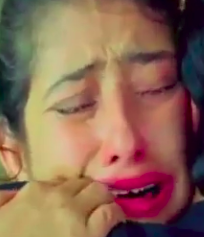

Image Loaded
[[[ 54  76  73]
  [ 54  75  74]
  [ 54  75  72]
  ...
  [ 64  89  94]
  [ 67  92  97]
  [ 71  96 102]]

 [[ 51  71  69]
  [ 51  72  70]
  [ 51  72  70]
  ...
  [ 71  94 100]
  [ 71  94 100]
  [ 73  96 103]]

 [[ 48  70  67]
  [ 47  69  66]
  [ 47  69  66]
  ...
  [ 76 101 106]
  [ 78 102 108]
  [ 77 100 107]]

 ...

 [[ 72 140 211]
  [ 72 140 211]
  [ 73 139 210]
  ...
  [ 67 112 112]
  [ 67 112 112]
  [ 67 112 112]]

 [[ 72 140 211]
  [ 72 140 211]
  [ 73 139 210]
  ...
  [ 67 112 112]
  [ 67 112 112]
  [ 67 112 112]]

 [[ 72 140 211]
  [ 72 140 211]
  [ 73 139 210]
  ...
  [ 67 112 112]
  [ 67 112 112]
  [ 67 112 112]]]


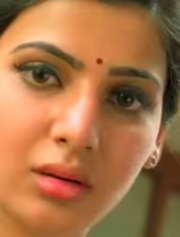

Image Loaded
[[[ 56 104 157]
  [ 57 105 156]
  [ 59 106 153]
  ...
  [120 179 238]
  [121 181 237]
  [121 183 234]]

 [[ 56 104 157]
  [ 58 105 155]
  [ 59 106 153]
  ...
  [120 180 238]
  [121 181 236]
  [121 183 234]]

 [[ 56 104 157]
  [ 58 106 154]
  [ 59 106 153]
  ...
  [120 180 238]
  [121 181 236]
  [121 183 234]]

 ...

 [[ 92 102 171]
  [ 95 107 177]
  [101 115 184]
  ...
  [ 95 153 223]
  [ 95 155 223]
  [ 98 156 226]]

 [[104 113 183]
  [105 116 186]
  [107 121 191]
  ...
  [ 94 153 223]
  [ 95 155 223]
  [ 98 156 225]]

 [[114 119 190]
  [111 119 190]
  [109 120 191]
  ...
  [ 95 153 223]
  [ 96 155 225]
  [ 97 155 225]]]


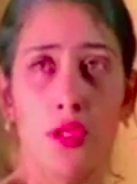

Image Loaded
[[[ 18  21  29]
  [ 18  21  29]
  [ 18  21  29]
  ...
  [ 15  16  26]
  [ 15  16  26]
  [ 16  17  26]]

 [[ 18  21  29]
  [ 18  21  29]
  [ 18  21  29]
  ...
  [ 15  16  26]
  [ 15  16  26]
  [ 15  16  26]]

 [[ 18  21  29]
  [ 18  21  29]
  [ 18  21  29]
  ...
  [ 14  15  25]
  [ 14  15  25]
  [ 15  16  26]]

 ...

 [[ 86 106 144]
  [ 79 100 137]
  [ 74  94 131]
  ...
  [ 17  21  27]
  [ 17  21  27]
  [ 18  22  27]]

 [[ 85 105 144]
  [ 82 103 140]
  [ 77  98 133]
  ...
  [ 16  21  25]
  [ 16  21  26]
  [ 17  22  26]]

 [[ 82 105 142]
  [ 83 105 141]
  [ 77  99 134]
  ...
  [ 15  20  25]
  [ 15  20  25]
  [ 16  21  26]]]


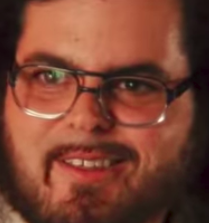

Image Loaded
[[[  6  43  87]
  [  7  42  84]
  [ 12  42  83]
  ...
  [ 30  49  54]
  [ 31  53  61]
  [ 30  55  66]]

 [[  0  38  82]
  [  0  37  79]
  [  3  39  80]
  ...
  [ 32  50  54]
  [ 32  53  60]
  [ 32  56  65]]

 [[  0  34  78]
  [  0  36  77]
  [  6  40  81]
  ...
  [ 33  52  55]
  [ 35  55  61]
  [ 36  59  66]]

 ...

 [[ 26  70 122]
  [ 30  71 123]
  [ 31  70 122]
  ...
  [219 244 234]
  [219 244 233]
  [219 244 233]]

 [[ 27  71 124]
  [ 27  69 121]
  [ 22  62 115]
  ...
  [222 248 234]
  [222 248 234]
  [222 248 236]]

 [[ 27  71 124]
  [ 24  66 119]
  [  7  54 107]
  ...
  [223 250 234]
  [223 250 234]
  [224 251 235]]]


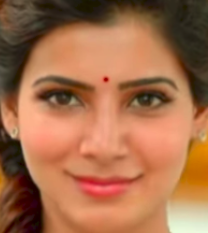

Image Loaded
[[[157 178 158]
  [157 180 169]
  [151 179 174]
  ...
  [ 93 127 113]
  [ 94 128 116]
  [ 90 124 112]]

 [[156 177 157]
  [155 179 167]
  [150 178 173]
  ...
  [ 87 119 106]
  [ 85 118 107]
  [ 80 113 102]]

 [[156 176 156]
  [152 176 164]
  [148 176 170]
  ...
  [ 71 102  90]
  [ 70 102  91]
  [ 71 103  93]]

 ...

 [[ 19  39  34]
  [  5  36  26]
  [  3  34  24]
  ...
  [210 221 255]
  [215 223 255]
  [217 226 255]]

 [[  6  35  28]
  [  0  32  21]
  [  0  31  21]
  ...
  [207 221 255]
  [213 223 255]
  [217 228 255]]

 [[  2  31  22]
  [  0  29  19]
  [  0  30  21]
  ...
  [202 219 252]
  [207 223 254]
  [214 226 255]]]


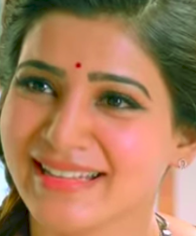

Image Loaded
[[[107 137 165]
  [ 96 126 153]
  [ 89 119 146]
  ...
  [ 87 106 117]
  [107 125 137]
  [129 145 159]]

 [[ 90 120 147]
  [ 80 109 137]
  [ 71  99 127]
  ...
  [101 121 133]
  [122 141 155]
  [143 161 175]]

 [[ 77 105 133]
  [ 67  96 124]
  [ 58  86 113]
  ...
  [100 120 131]
  [118 137 150]
  [136 154 168]]

 ...

 [[ 68 138 176]
  [ 68 138 176]
  [ 68 138 176]
  ...
  [168 174 191]
  [191 184 209]
  [210 190 223]]

 [[ 68 138 176]
  [ 68 138 176]
  [ 68 138 176]
  ...
  [172 177 195]
  [194 186 211]
  [211 191 224]]

 [[ 68 138 176]
  [ 68 138 176]
  [ 68 138 176]
  ...
  [178 181 199]
  [197 188 214]
  [214 193 226]]]


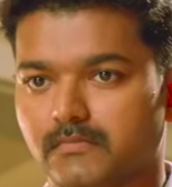

Image Loaded
[[[ 18   0  30]
  [ 27  17  43]
  [ 44  40  65]
  ...
  [ 52  75 112]
  [ 61  82 120]
  [ 73  95 133]]

 [[ 17   0  30]
  [ 22  13  39]
  [ 37  34  58]
  ...
  [ 53  76 113]
  [ 58  79 117]
  [ 65  87 125]]

 [[ 17   0  31]
  [ 15   4  31]
  [ 18  14  39]
  ...
  [ 56  79 115]
  [ 56  78 115]
  [ 61  82 120]]

 ...

 [[ 35  51  71]
  [ 36  53  72]
  [ 40  55  75]
  ...
  [ 41  68  83]
  [ 41  68  83]
  [ 40  66  84]]

 [[ 36  53  72]
  [ 40  56  75]
  [ 42  58  77]
  ...
  [ 40  67  81]
  [ 40  67  82]
  [ 40  66  84]]

 [[ 40  56  75]
  [ 42  57  76]
  [ 41  57  76]
  ...
  [ 40  66  80]
  [ 39  65  80]
  [ 40  65  83]]]


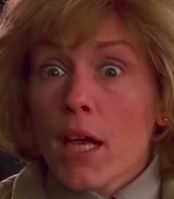

Image Loaded
[[[ 53  66  84]
  [ 66  75  87]
  [ 76  77  84]
  ...
  [ 79 113 166]
  [ 79 113 166]
  [ 78 112 165]]

 [[ 52  65  81]
  [ 70  77  86]
  [ 89  89  90]
  ...
  [ 79 113 166]
  [ 79 113 166]
  [ 78 112 165]]

 [[ 50  60  75]
  [ 67  70  78]
  [ 96  92  91]
  ...
  [ 81 115 168]
  [ 81 115 168]
  [ 79 113 166]]

 ...

 [[  0   0  29]
  [  2   2  31]
  [ 23  22  36]
  ...
  [ 92 202 210]
  [ 91 199 209]
  [103 202 208]]

 [[  0   0  29]
  [  1   1  29]
  [ 16  16  33]
  ...
  [108 212 215]
  [ 98 208 212]
  [ 99 206 208]]

 [[  0   0  30]
  [  0   0  29]
  [  7   7  32]
  ...
  [126 220 218]
  [113 217 215]
  [106 213 212]]]


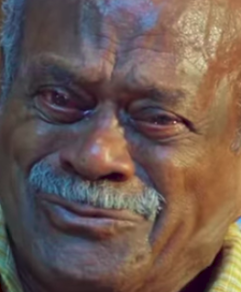

Image Loaded
[[[138 126 100]
  [137 125 100]
  [135 123  99]
  ...
  [131 117  90]
  [131 117  90]
  [131 117  90]]

 [[137 125 100]
  [137 125 100]
  [136 124  99]
  ...
  [130 116  89]
  [130 116  89]
  [130 116  89]]

 [[137 125  99]
  [136 124 100]
  [136 124  99]
  ...
  [130 116  89]
  [130 116  89]
  [130 116  89]]

 ...

 [[172 146  75]
  [173 147  76]
  [173 148  76]
  ...
  [111  72  33]
  [112  71  34]
  [112  71  34]]

 [[173 145  75]
  [173 146  75]
  [172 147  76]
  ...
  [112  72  34]
  [112  71  34]
  [114  70  35]]

 [[173 144  75]
  [172 145  76]
  [172 147  76]
  ...
  [113  72  35]
  [113  72  34]
  [115  71  36]]]


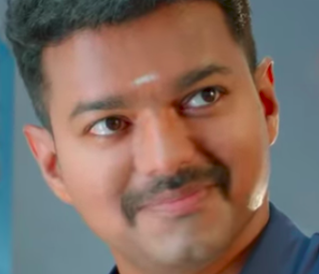

Image Loaded
[[[ 48  51  32]
  [ 52  56  35]
  [ 61  65  43]
  ...
  [ 85  72  65]
  [ 89  70  63]
  [ 93  67  62]]

 [[ 46  49  30]
  [ 55  58  38]
  [ 63  67  45]
  ...
  [ 85  70  62]
  [ 89  68  58]
  [ 93  65  57]]

 [[ 47  50  32]
  [ 58  61  42]
  [ 65  67  47]
  ...
  [ 86  67  58]
  [ 89  64  56]
  [ 92  63  55]]

 ...

 [[ 27  44  74]
  [ 47  69 101]
  [ 51  73 107]
  ...
  [  0   0 124]
  [  0   0 125]
  [  0   0 126]]

 [[ 30  46  76]
  [ 56  77 110]
  [ 57  79 113]
  ...
  [  0   0 126]
  [  0   0 125]
  [  0   0 124]]

 [[ 26  40  69]
  [ 49  68  99]
  [ 47  67 101]
  ...
  [ 33   0 138]
  [ 26   0 134]
  [ 18   0 130]]]


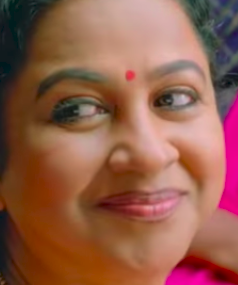

Image Loaded
[[[48 44 35]
  [48 44 35]
  [48 44 35]
  ...
  [53 51 43]
  [53 51 43]
  [53 51 43]]

 [[48 44 35]
  [48 44 35]
  [48 44 35]
  ...
  [53 50 41]
  [53 50 42]
  [53 50 42]]

 [[48 44 35]
  [48 44 35]
  [48 44 35]
  ...
  [52 48 40]
  [53 49 40]
  [53 49 41]]

 ...

 [[47 45 38]
  [47 45 38]
  [47 45 38]
  ...
  [44 42 34]
  [45 43 34]
  [45 44 33]]

 [[47 45 38]
  [47 45 38]
  [47 45 38]
  ...
  [45 43 34]
  [45 44 34]
  [45 44 33]]

 [[47 45 38]
  [47 45 38]
  [47 45 38]
  ...
  [45 44 35]
  [45 44 34]
  [45 44 33]]]


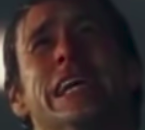

Image Loaded
[[[ 90 104 106]
  [ 93 106 108]
  [ 98 110 114]
  ...
  [116 139 134]
  [100 128 122]
  [ 91 122 116]]

 [[ 90 103 104]
  [ 95 107 109]
  [ 99 111 112]
  ...
  [120 142 137]
  [104 130 127]
  [ 90 119 115]]

 [[ 96 109 110]
  [ 99 112 113]
  [101 114 115]
  ...
  [122 143 138]
  [110 134 131]
  [ 93 119 115]]

 ...

 [[191 157 234]
  [207 180 211]
  [213 187 187]
  ...
  [158 195 193]
  [157 195 193]
  [158 195 193]]

 [[211 180 245]
  [234 207 227]
  [227 202 191]
  ...
  [157 194 192]
  [156 193 191]
  [157 194 192]]

 [[233 204 253]
  [254 228 237]
  [231 205 188]
  ...
  [156 192 190]
  [156 192 190]
  [157 194 192]]]


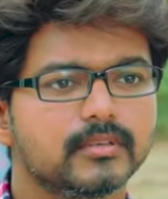

Image Loaded
[[[ 49  63  45]
  [ 50  64  53]
  [ 50  64  62]
  ...
  [ 95 131 198]
  [115 147 229]
  [128 161 251]]

 [[ 49  63  45]
  [ 48  64  54]
  [ 48  64  64]
  ...
  [ 86 120 184]
  [110 143 221]
  [125 160 245]]

 [[ 48  63  45]
  [ 48  64  55]
  [ 48  65  67]
  ...
  [ 75 107 162]
  [101 134 204]
  [119 152 234]]

 ...

 [[100 104  68]
  [101 103  73]
  [100 100  76]
  ...
  [152 162  84]
  [152 162  85]
  [153 163  85]]

 [[100 103  63]
  [101 103  67]
  [101 102  69]
  ...
  [152 162  85]
  [153 163  85]
  [154 164  86]]

 [[102 105  61]
  [105 106  65]
  [106 106  67]
  ...
  [153 163  85]
  [154 164  86]
  [154 164  86]]]


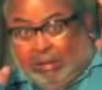

Image Loaded
[[[103 111 106]
  [102 110 104]
  [102 110 105]
  ...
  [134 134 160]
  [135 135 163]
  [137 136 165]]

 [[104 112 108]
  [102 110 106]
  [103 111 107]
  ...
  [134 134 161]
  [137 136 164]
  [139 139 168]]

 [[105 111 110]
  [103 111 108]
  [104 111 109]
  ...
  [134 133 162]
  [138 137 166]
  [140 140 169]]

 ...

 [[ 18  26  24]
  [ 20  26  26]
  [ 23  28  29]
  ...
  [125 151 187]
  [121 147 182]
  [116 143 176]]

 [[ 21  27  27]
  [ 23  28  29]
  [ 27  32  33]
  ...
  [125 150 188]
  [124 150 185]
  [122 150 183]]

 [[ 26  31  32]
  [ 28  33  34]
  [ 32  37  38]
  ...
  [124 150 187]
  [125 151 186]
  [124 152 185]]]


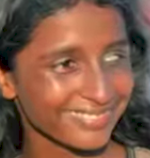

Image Loaded
[[[ 53 120 139]
  [ 53 120 139]
  [ 53 120 138]
  ...
  [255 244 232]
  [242 210 203]
  [236 206 197]]

 [[ 52 122 138]
  [ 52 122 138]
  [ 52 120 138]
  ...
  [255 236 227]
  [239 209 202]
  [233 202 196]]

 [[ 51 120 140]
  [ 51 120 139]
  [ 52 120 139]
  ...
  [242 225 215]
  [236 206 200]
  [231 200 194]]

 ...

 [[ 33  76 141]
  [ 32  78 140]
  [ 33  80 141]
  ...
  [112 130 162]
  [110 127 161]
  [107 126 163]]

 [[ 34  77 141]
  [ 34  78 140]
  [ 34  80 142]
  ...
  [ 89 108 156]
  [ 89 109 159]
  [ 88 108 161]]

 [[ 35  79 141]
  [ 35  79 141]
  [ 35  80 142]
  ...
  [ 78 100 162]
  [ 80 101 167]
  [ 80 101 171]]]


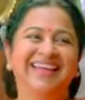

Image Loaded
[[[  9 124 167]
  [ 14 124 166]
  [ 11 125 166]
  ...
  [ 75 125 134]
  [ 75 125 134]
  [ 75 125 134]]

 [[ 12 123 168]
  [ 16 124 167]
  [ 14 124 166]
  ...
  [ 75 125 134]
  [ 75 125 134]
  [ 75 125 134]]

 [[ 12 123 168]
  [ 12 123 168]
  [ 13 124 167]
  ...
  [ 75 125 134]
  [ 75 125 134]
  [ 75 125 134]]

 ...

 [[ 41  75  98]
  [ 48  82 104]
  [ 51  88 108]
  ...
  [ 63 101 119]
  [ 61 104 119]
  [ 59 107 120]]

 [[ 40  73  96]
  [ 46  80 102]
  [ 51  86 107]
  ...
  [ 64 105 121]
  [ 60 105 119]
  [ 59 107 120]]

 [[ 39  70  95]
  [ 44  78  99]
  [ 48  84 105]
  ...
  [ 62 105 121]
  [ 61 107 121]
  [ 60 108 121]]]


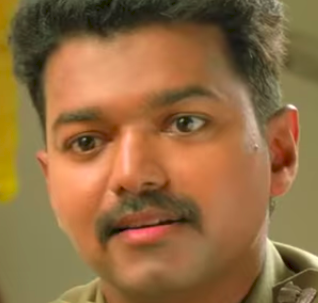

Image Loaded
[[[ 21  49  77]
  [ 19  47  75]
  [ 18  45  72]
  ...
  [ 69  89  77]
  [ 66  83  70]
  [ 62  77  58]]

 [[ 11  42  71]
  [  8  39  68]
  [ 15  46  73]
  ...
  [ 69  90  84]
  [ 70  89  80]
  [ 66  82  69]]

 [[  0  38  66]
  [  0  32  60]
  [  7  43  70]
  ...
  [ 70  92  82]
  [ 72  93  82]
  [ 68  87  74]]

 ...

 [[  0  43 111]
  [  0  42 111]
  [  0  42 110]
  ...
  [ 43  95 121]
  [ 42  95 120]
  [ 43  95 121]]

 [[  0  42 110]
  [  0  41 109]
  [  0  40 108]
  ...
  [ 43  96 121]
  [ 43  95 121]
  [ 43  95 121]]

 [[  0  40 109]
  [  0  40 108]
  [  0  39 107]
  ...
  [ 43  95 120]
  [ 42  94 120]
  [ 42  94 120]]]


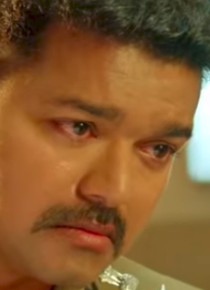

Image Loaded
[[[  0  50  97]
  [  0  43  86]
  [  0  39  77]
  ...
  [ 89 182 236]
  [ 87 186 238]
  [ 86 188 240]]

 [[  0  44  90]
  [  0  39  80]
  [  0  35  72]
  ...
  [ 89 179 233]
  [ 87 184 236]
  [ 87 187 239]]

 [[  0  39  83]
  [  0  36  75]
  [  0  33  68]
  ...
  [ 88 174 228]
  [ 89 181 234]
  [ 88 186 238]]

 ...

 [[ 21  22  38]
  [ 22  22  38]
  [ 22  22  37]
  ...
  [  0 104 174]
  [  1 106 176]
  [ 34 126 194]]

 [[ 22  22  38]
  [ 22  22  38]
  [ 23  22  37]
  ...
  [  0 101 171]
  [  0 100 171]
  [ 29 123 191]]

 [[ 22  23  38]
  [ 22  22  38]
  [ 23  23  37]
  ...
  [  0  99 170]
  [  0  94 165]
  [ 23 118 187]]]


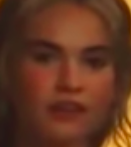

Image Loaded
[[[ 54  72  71]
  [ 53  69  67]
  [ 50  63  63]
  ...
  [ 45  59  69]
  [ 40  53  64]
  [ 40  53  64]]

 [[ 53  71  69]
  [ 52  67  66]
  [ 51  64  65]
  ...
  [ 53  67  77]
  [ 42  56  67]
  [ 40  53  63]]

 [[ 53  70  68]
  [ 51  66  66]
  [ 49  64  64]
  ...
  [ 57  71  81]
  [ 48  61  73]
  [ 40  53  63]]

 ...

 [[ 15  25  31]
  [ 14  29  31]
  [ 49  71  66]
  ...
  [ 28  47  56]
  [ 28  47  58]
  [ 29  49  60]]

 [[ 18  32  36]
  [ 20  40  40]
  [ 78 104  98]
  ...
  [ 27  49  55]
  [ 29  49  59]
  [ 32  53  63]]

 [[ 18  34  37]
  [ 49  72  70]
  [ 97 128 121]
  ...
  [ 27  49  55]
  [ 29  49  58]
  [ 31  51  61]]]


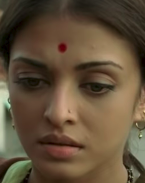

Image Loaded
[[[ 33  56  50]
  [ 42  66  58]
  [ 44  68  59]
  ...
  [ 87 132  99]
  [ 85 133  98]
  [ 85 133  99]]

 [[ 39  63  55]
  [ 47  72  63]
  [ 44  68  59]
  ...
  [ 86 133  98]
  [ 85 134  98]
  [ 85 132 100]]

 [[ 45  69  62]
  [ 47  72  63]
  [ 42  66  56]
  ...
  [ 86 134  99]
  [ 85 134  98]
  [ 85 134  99]]

 ...

 [[ 14  28  25]
  [ 13  27  24]
  [  0  24  20]
  ...
  [ 30  95  62]
  [ 31  95  60]
  [ 31  95  59]]

 [[  0  27  22]
  [  0  26  21]
  [  0  23  18]
  ...
  [ 30  94  62]
  [ 30  94  62]
  [ 31  95  60]]

 [[  0  30  26]
  [  0  27  22]
  [  0  22  19]
  ...
  [ 30  94  62]
  [ 30  94  62]
  [ 31  95  61]]]


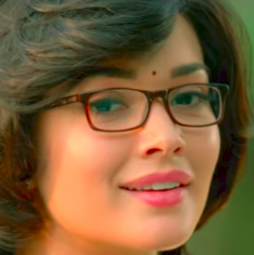

Image Loaded
[[[ 21  26  43]
  [ 21  27  43]
  [ 18  25  40]
  ...
  [ 14  20  27]
  [ 14  20  27]
  [ 15  21  28]]

 [[ 14  20  37]
  [ 17  22  39]
  [ 16  23  38]
  ...
  [ 13  18  26]
  [ 11  19  27]
  [ 13  20  27]]

 [[ 12  18  35]
  [ 13  19  35]
  [ 13  20  35]
  ...
  [ 10  18  25]
  [ 11  19  26]
  [ 13  20  26]]

 ...

 [[ 61  79 115]
  [ 37  54  89]
  [ 23  38  75]
  ...
  [ 13  14  23]
  [ 13  14  24]
  [ 13  14  24]]

 [[ 69  88 123]
  [ 49  66  99]
  [ 29  45  77]
  ...
  [ 13  14  23]
  [ 13  14  23]
  [ 13  14  23]]

 [[ 75  95 130]
  [ 59  77 109]
  [ 38  54  85]
  ...
  [ 12  13  24]
  [ 12  13  23]
  [ 12  13  24]]]


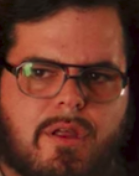

Image Loaded
[[[237 196 122]
  [237 196 122]
  [237 196 122]
  ...
  [238 196 126]
  [238 196 126]
  [238 196 126]]

 [[238 197 122]
  [238 197 122]
  [238 197 122]
  ...
  [239 197 126]
  [239 197 126]
  [239 197 126]]

 [[238 197 122]
  [238 197 122]
  [238 197 122]
  ...
  [239 197 126]
  [239 197 126]
  [239 197 126]]

 ...

 [[236 196 123]
  [236 196 123]
  [236 196 123]
  ...
  [237 197 128]
  [237 197 128]
  [237 197 128]]

 [[236 196 123]
  [236 196 123]
  [236 196 123]
  ...
  [237 197 128]
  [237 197 128]
  [237 197 128]]

 [[236 196 123]
  [236 196 123]
  [236 196 123]
  ...
  [237 197 128]
  [237 197 128]
  [237 197 128]]]


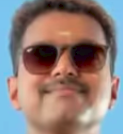

Image Loaded
[[[ 70  78  93]
  [ 36  43  58]
  [ 58  66  77]
  ...
  [250 241 213]
  [250 241 213]
  [250 241 213]]

 [[ 57  65  79]
  [ 62  70  80]
  [ 54  61  71]
  ...
  [250 240 215]
  [250 242 213]
  [250 242 212]]

 [[ 43  50  59]
  [ 56  62  74]
  [ 57  66  75]
  ...
  [250 238 218]
  [250 242 212]
  [250 241 213]]

 ...

 [[165 158 157]
  [187 170 164]
  [207 184 180]
  ...
  [ 18  33  71]
  [ 27  42  83]
  [  7  21  40]]

 [[184 174 166]
  [199 181 163]
  [207 184 183]
  ...
  [ 20  33  68]
  [ 21  33  69]
  [ 11  24  53]]

 [[142 139 134]
  [138 136 127]
  [126 122 119]
  ...
  [  7  25  58]
  [ 15  27  63]
  [ 26  38  79]]]


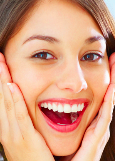

Image Loaded
[[[35 37 68]
  [35 38 67]
  [33 37 65]
  ...
  [42 52 80]
  [47 57 88]
  [50 61 94]]

 [[35 37 67]
  [35 37 65]
  [33 36 63]
  ...
  [42 51 77]
  [46 56 85]
  [50 60 92]]

 [[35 37 65]
  [34 36 63]
  [32 34 61]
  ...
  [41 49 75]
  [46 55 83]
  [50 59 90]]

 ...

 [[49 54 79]
  [50 57 87]
  [48 57 91]
  ...
  [30 29 31]
  [30 29 31]
  [30 29 31]]

 [[47 52 73]
  [49 56 82]
  [48 56 87]
  ...
  [30 29 31]
  [30 29 31]
  [30 29 31]]

 [[44 49 67]
  [47 53 77]
  [47 55 83]
  ...
  [30 29 31]
  [30 29 31]
  [30 29 31]]]


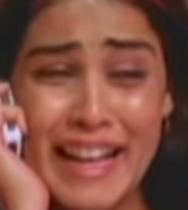

Image Loaded
[[[  1  31  40]
  [ 19  45  53]
  [ 48  74  81]
  ...
  [115 149 159]
  [120 155 166]
  [125 161 171]]

 [[  8  35  44]
  [ 39  63  70]
  [ 80 108 115]
  ...
  [109 143 152]
  [119 154 163]
  [124 160 169]]

 [[ 24  48  55]
  [ 68  94 100]
  [118 147 154]
  ...
  [ 98 131 140]
  [115 150 159]
  [122 158 167]]

 ...

 [[ 29  33  22]
  [ 29  32  20]
  [ 27  30  18]
  ...
  [ 14  14  21]
  [  5  16  20]
  [ 13  20  22]]

 [[ 29  32  21]
  [ 28  31  20]
  [ 26  29  17]
  ...
  [  5   5   8]
  [  0   6   7]
  [  5   8  19]]

 [[ 28  31  20]
  [ 27  30  18]
  [ 25  29  13]
  ...
  [  9   9  14]
  [  9  12  14]
  [ 15  18  25]]]


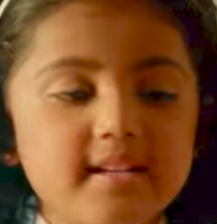

Image Loaded
[[[ 90 134 151]
  [ 90 134 151]
  [ 90 134 151]
  ...
  [ 67 107 154]
  [ 66 106 153]
  [ 65 104 152]]

 [[ 90 135 152]
  [ 90 135 152]
  [ 90 135 152]
  ...
  [ 67 107 155]
  [ 66 106 153]
  [ 65 105 152]]

 [[ 90 135 152]
  [ 90 135 152]
  [ 90 135 152]
  ...
  [ 67 108 155]
  [ 66 107 154]
  [ 64 105 152]]

 ...

 [[ 69 106 120]
  [ 78 117 130]
  [ 90 129 142]
  ...
  [ 38  70  88]
  [ 40  72  90]
  [ 39  70  89]]

 [[ 62  99 113]
  [ 75 113 127]
  [ 89 129 142]
  ...
  [ 36  66  85]
  [ 37  66  86]
  [ 35  64  83]]

 [[ 60  96 111]
  [ 75 113 127]
  [ 89 127 142]
  ...
  [ 34  62  82]
  [ 33  61  81]
  [ 30  57  77]]]


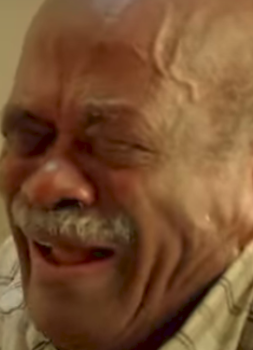

Image Loaded
[[[118 132 135]
  [116 136 135]
  [115 141 134]
  ...
  [114 150 133]
  [116 147 135]
  [122 144 138]]

 [[118 130 135]
  [116 135 134]
  [115 141 134]
  ...
  [114 150 133]
  [116 148 135]
  [120 145 137]]

 [[120 132 136]
  [117 136 135]
  [116 142 135]
  ...
  [114 151 133]
  [115 150 134]
  [119 148 136]]

 ...

 [[107 130 113]
  [113 129 110]
  [119 126 107]
  ...
  [133 135 115]
  [139 135 114]
  [142 135 113]]

 [[107 131 111]
  [113 129 109]
  [119 127 106]
  ...
  [133 135 115]
  [139 135 114]
  [142 134 114]]

 [[107 131 111]
  [113 129 109]
  [119 127 104]
  ...
  [133 135 115]
  [139 135 114]
  [143 134 114]]]


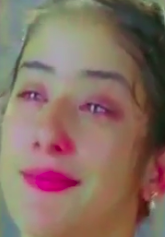

Image Loaded
[[[ 65  76  66]
  [ 66  75  66]
  [ 65  73  64]
  ...
  [222 199 185]
  [222 199 184]
  [221 198 183]]

 [[ 66  77  67]
  [ 67  76  67]
  [ 66  75  66]
  ...
  [222 199 186]
  [222 199 185]
  [221 198 183]]

 [[ 67  77  68]
  [ 69  78  68]
  [ 68  76  67]
  ...
  [223 200 187]
  [222 199 186]
  [221 198 183]]

 ...

 [[ 98 120 156]
  [ 98 120 158]
  [ 98 120 159]
  ...
  [ 25  53 109]
  [ 28  56 112]
  [ 28  57 112]]

 [[ 98 120 161]
  [ 98 120 161]
  [ 98 120 162]
  ...
  [ 26  55 110]
  [ 29  57 113]
  [ 29  58 113]]

 [[101 121 166]
  [100 121 166]
  [100 122 165]
  ...
  [ 29  56 112]
  [ 30  58 113]
  [ 30  59 114]]]


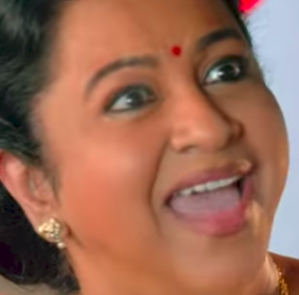

Image Loaded
[[[ 40  60  82]
  [ 40  60  82]
  [ 40  60  82]
  ...
  [111 112 148]
  [113 116 145]
  [117 117 144]]

 [[ 40  59  81]
  [ 40  59  81]
  [ 40  59  81]
  ...
  [108 112 148]
  [112 114 145]
  [117 116 144]]

 [[ 39  59  81]
  [ 39  59  81]
  [ 39  59  81]
  ...
  [106 111 147]
  [110 114 145]
  [115 115 144]]

 ...

 [[ 78  93  77]
  [ 68  78  63]
  [ 69  76  61]
  ...
  [141 203 204]
  [136 203 204]
  [132 202 206]]

 [[ 77  93  71]
  [ 73  84  62]
  [ 79  87  65]
  ...
  [147 212 209]
  [142 207 207]
  [138 203 209]]

 [[ 75  91  66]
  [ 75  87  60]
  [ 85  93  65]
  ...
  [153 219 215]
  [150 213 213]
  [147 210 215]]]


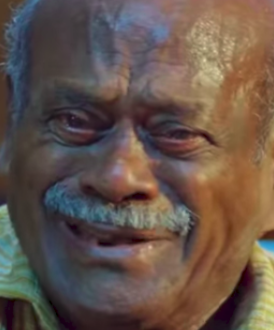

Image Loaded
[[[113 167 212]
  [113 165 210]
  [ 93 142 189]
  ...
  [ 54  95 121]
  [ 46  81 105]
  [ 28  55  78]]

 [[110 163 208]
  [104 155 202]
  [ 83 131 178]
  ...
  [ 79 122 149]
  [ 59  96 122]
  [ 45  75  99]]

 [[108 160 206]
  [ 93 143 189]
  [ 77 124 172]
  ...
  [ 95 141 168]
  [ 69 108 135]
  [ 59  92 118]]

 ...

 [[ 45  88 145]
  [ 34  78 137]
  [ 30  76 134]
  ...
  [ 31  64 119]
  [ 27  60 116]
  [ 29  63 119]]

 [[ 46  89 146]
  [ 35  79 138]
  [ 31  76 135]
  ...
  [ 30  63 118]
  [ 27  61 116]
  [ 27  63 117]]

 [[ 48  90 149]
  [ 35  79 138]
  [ 31  76 134]
  ...
  [ 31  66 116]
  [ 27  63 116]
  [ 29  64 119]]]


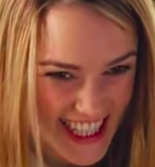

Image Loaded
[[[ 65  47  44]
  [ 65  48  45]
  [ 67  51  47]
  ...
  [ 62  55  60]
  [ 62  56  60]
  [ 62  56  60]]

 [[ 66  49  43]
  [ 67  51  45]
  [ 68  54  47]
  ...
  [ 61  56  59]
  [ 61  56  60]
  [ 62  56  60]]

 [[ 67  51  45]
  [ 68  53  46]
  [ 70  56  48]
  ...
  [ 62  56  60]
  [ 62  56  60]
  [ 62  56  61]]

 ...

 [[ 51  46  41]
  [ 50  46  41]
  [ 50  45  40]
  ...
  [ 78 125 196]
  [ 74 122 193]
  [ 73 121 187]]

 [[ 49  45  38]
  [ 50  45  40]
  [ 50  45  40]
  ...
  [ 78 127 195]
  [ 74 122 193]
  [ 73 121 187]]

 [[ 45  41  35]
  [ 45  41  36]
  [ 45  41  37]
  ...
  [ 78 125 196]
  [ 74 124 192]
  [ 74 121 187]]]


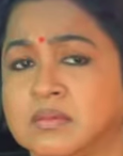

Image Loaded
[[[ 38  29  30]
  [ 38  29  30]
  [ 40  30  33]
  ...
  [101  63  78]
  [100  63  77]
  [100  63  77]]

 [[ 39  29  31]
  [ 39  29  32]
  [ 42  31  34]
  ...
  [101  63  78]
  [100  63  77]
  [100  63  77]]

 [[ 40  30  33]
  [ 41  31  34]
  [ 44  33  35]
  ...
  [101  63  78]
  [100  63  77]
  [100  63  77]]

 ...

 [[ 86 100 160]
  [ 87 103 162]
  [ 91 107 166]
  ...
  [117 138 135]
  [115 137 132]
  [111 131 125]]

 [[ 86 101 163]
  [ 88 103 165]
  [ 91 108 167]
  ...
  [129 175 164]
  [131 175 166]
  [129 171 162]]

 [[ 89 103 167]
  [ 91 106 168]
  [ 93 109 168]
  ...
  [124 189 175]
  [125 190 175]
  [125 188 174]]]


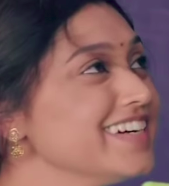

Image Loaded
[[[ 76  98 122]
  [ 76  98 122]
  [ 76  98 123]
  ...
  [ 52  67  84]
  [ 52  67  84]
  [ 53  68  85]]

 [[ 76  98 122]
  [ 76  98 122]
  [ 76  98 123]
  ...
  [ 53  68  85]
  [ 53  68  85]
  [ 53  68  85]]

 [[ 77  99 123]
  [ 77  99 123]
  [ 77  99 123]
  ...
  [ 53  68  85]
  [ 53  68  85]
  [ 53  68  85]]

 ...

 [[ 54 106 161]
  [ 50 102 155]
  [ 51 103 155]
  ...
  [ 72  95 135]
  [ 71  89 132]
  [ 71  86 130]]

 [[ 55 107 163]
  [ 50 102 155]
  [ 51 103 154]
  ...
  [ 89 112 153]
  [ 92 114 156]
  [ 93 110 153]]

 [[ 53 107 161]
  [ 51 104 156]
  [ 53 105 156]
  ...
  [109 134 174]
  [113 137 177]
  [110 132 172]]]


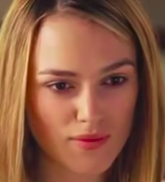

Image Loaded
[[[  0  75 180]
  [  0  78 180]
  [  0  87 186]
  ...
  [ 41  74   3]
  [ 35  74   0]
  [ 32  73   0]]

 [[  0  80 187]
  [  0  83 186]
  [  0  90 190]
  ...
  [ 41  77   1]
  [ 34  74   0]
  [ 29  74   0]]

 [[  0  91 197]
  [  0  89 193]
  [  0  93 196]
  ...
  [ 43  81   0]
  [ 35  76   0]
  [ 30  74   0]]

 ...

 [[ 12   0  13]
  [ 11   0  13]
  [ 11   0  13]
  ...
  [104 179   0]
  [109 184   0]
  [107 182   0]]

 [[ 12   0  15]
  [ 11   0  13]
  [ 10   0  13]
  ...
  [103 175   0]
  [107 179   0]
  [106 177   0]]

 [[ 12   0  15]
  [  8   0  13]
  [  6   0  13]
  ...
  [ 99 170   0]
  [104 175   0]
  [104 174   0]]]


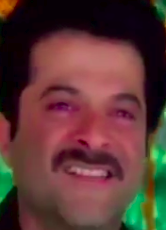

Image Loaded
[[[ 40  38  31]
  [ 40  38  31]
  [ 39  37  30]
  ...
  [ 37  35  29]
  [ 36  35  28]
  [ 36  35  28]]

 [[ 40  38  31]
  [ 40  38  31]
  [ 39  37  31]
  ...
  [ 37  35  29]
  [ 36  35  28]
  [ 36  35  28]]

 [[ 40  38  31]
  [ 40  38  31]
  [ 40  38  31]
  ...
  [ 36  36  30]
  [ 36  35  30]
  [ 36  35  28]]

 ...

 [[ 92 107 100]
  [100 118 109]
  [110 131 120]
  ...
  [ 56  89  76]
  [ 56  86  75]
  [ 54  81  73]]

 [[125 142 134]
  [132 154 142]
  [134 158 145]
  ...
  [ 57  92  78]
  [ 58  91  78]
  [ 58  89  77]]

 [[159 181 170]
  [155 180 167]
  [142 170 154]
  ...
  [ 53  91  75]
  [ 55  91  75]
  [ 56  90  75]]]


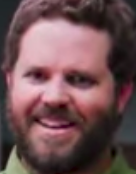

Image Loaded
[[[101  75  80]
  [101  75  80]
  [101  75  80]
  ...
  [ 94  75  79]
  [ 96  76  79]
  [ 97  76  78]]

 [[101  75  81]
  [101  75  80]
  [101  75  80]
  ...
  [ 93  74  78]
  [ 95  76  79]
  [ 96  77  78]]

 [[ 99  73  79]
  [ 99  74  79]
  [100  74  79]
  ...
  [ 91  74  78]
  [ 94  76  79]
  [ 96  77  78]]

 ...

 [[130 160 145]
  [133 165 149]
  [137 171 154]
  ...
  [ 63 115  89]
  [ 62 114  88]
  [ 61 113  88]]

 [[132 166 149]
  [134 168 152]
  [135 172 154]
  ...
  [ 63 115  90]
  [ 62 114  89]
  [ 62 113  89]]

 [[134 172 154]
  [134 172 154]
  [133 173 154]
  ...
  [ 63 116  91]
  [ 63 115  90]
  [ 62 114  90]]]


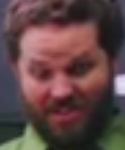

Image Loaded
[[[134 166 182]
  [134 166 182]
  [134 166 182]
  ...
  [216 207 213]
  [218 213 220]
  [216 217 222]]

 [[134 166 182]
  [134 166 182]
  [132 164 180]
  ...
  [216 209 212]
  [216 215 217]
  [216 218 219]]

 [[132 168 180]
  [132 168 180]
  [135 169 181]
  ...
  [208 207 202]
  [214 219 212]
  [215 223 215]]

 ...

 [[ 54  54  90]
  [ 51  51  87]
  [ 74  75 111]
  ...
  [ 55  62  92]
  [ 65  68  95]
  [ 71  75  99]]

 [[ 63  64 100]
  [ 48  50  85]
  [ 70  72 108]
  ...
  [ 68  75 105]
  [ 41  44  71]
  [ 70  74  98]]

 [[ 63  66  99]
  [ 48  50  85]
  [ 67  69 105]
  ...
  [ 71  74 107]
  [ 72  76 103]
  [ 17  21  43]]]


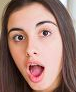

Image Loaded
[[[ 50  50  50]
  [ 50  50  50]
  [ 49  49  49]
  ...
  [ 62  62  62]
  [ 62  62  62]
  [ 59  59  59]]

 [[ 52  52  52]
  [ 52  52  52]
  [ 51  51  51]
  ...
  [ 63  63  63]
  [ 62  62  62]
  [ 61  61  61]]

 [[ 51  51  51]
  [ 52  52  52]
  [ 51  51  51]
  ...
  [ 67  67  67]
  [ 65  65  65]
  [ 64  64  64]]

 ...

 [[180 180 180]
  [180 180 180]
  [178 178 178]
  ...
  [221 221 221]
  [221 221 221]
  [221 221 221]]

 [[182 182 182]
  [182 182 182]
  [180 180 180]
  ...
  [221 221 221]
  [221 221 221]
  [220 220 220]]

 [[184 184 184]
  [183 183 183]
  [182 182 182]
  ...
  [220 220 220]
  [220 220 220]
  [221 221 221]]]


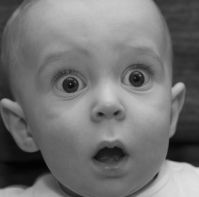

Image Loaded
[[[ 34  46  58]
  [ 33  44  57]
  [ 30  42  57]
  ...
  [118 173 199]
  [117 172 199]
  [115 170 198]]

 [[ 34  45  57]
  [ 32  43  56]
  [ 30  42  56]
  ...
  [120 172 200]
  [118 169 198]
  [114 166 195]]

 [[ 32  44  56]
  [ 31  43  55]
  [ 30  41  56]
  ...
  [122 172 200]
  [118 169 197]
  [113 164 192]]

 ...

 [[ 28  37  53]
  [ 27  36  54]
  [ 27  36  54]
  ...
  [ 44 108 158]
  [ 43 107 156]
  [ 41 104 149]]

 [[ 30  40  56]
  [ 29  39  56]
  [ 29  38  56]
  ...
  [ 43 106 156]
  [ 42 105 154]
  [ 41 103 150]]

 [[ 31  43  58]
  [ 31  43  58]
  [ 31  43  58]
  ...
  [ 41 103 153]
  [ 39 102 151]
  [ 39 101 147]]]


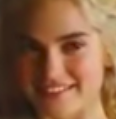

Image Loaded
[[[ 36  51  48]
  [ 41  53  50]
  [ 43  53  49]
  ...
  [ 50  65  63]
  [ 46  66  64]
  [ 45  66  67]]

 [[ 39  53  50]
  [ 43  54  50]
  [ 41  49  45]
  ...
  [ 49  64  60]
  [ 46  63  61]
  [ 44  63  63]]

 [[ 40  52  49]
  [ 40  49  45]
  [ 36  44  40]
  ...
  [ 48  61  58]
  [ 45  60  57]
  [ 43  60  58]]

 ...

 [[143 178 171]
  [144 178 171]
  [145 179 172]
  ...
  [ 34  54  49]
  [ 44  66  55]
  [ 53  78  63]]

 [[144 179 171]
  [145 180 172]
  [146 181 173]
  ...
  [ 33  55  49]
  [ 48  74  61]
  [ 60  90  71]]

 [[145 180 172]
  [147 182 173]
  [148 182 174]
  ...
  [ 33  57  54]
  [ 51  79  67]
  [ 60  95  70]]]


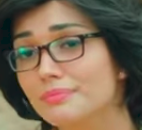

Image Loaded
[[[ 72  40  41]
  [ 71  39  40]
  [ 71  39  40]
  ...
  [ 63  31  33]
  [ 64  32  32]
  [ 64  32  32]]

 [[ 71  39  40]
  [ 71  39  40]
  [ 71  39  40]
  ...
  [ 62  32  33]
  [ 64  30  33]
  [ 65  32  33]]

 [[ 71  39  40]
  [ 71  39  40]
  [ 71  38  40]
  ...
  [ 63  33  34]
  [ 65  33  34]
  [ 65  32  33]]

 ...

 [[177 155 194]
  [178 156 196]
  [180 157 197]
  ...
  [204 195 221]
  [204 192 220]
  [203 191 219]]

 [[177 156 195]
  [178 156 196]
  [180 157 197]
  ...
  [202 194 219]
  [203 191 219]
  [202 190 218]]

 [[177 157 195]
  [177 156 195]
  [180 158 198]
  ...
  [200 192 216]
  [202 190 217]
  [202 190 217]]]


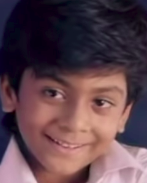

In [ ]:
from keras.models import model_from_json
#import numpy
#import os
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import glob
import csv

#loading the model
json_file = open('/content/drive/My Drive/hsnsfer1.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("/content/drive/My Drive/hsnsfer1.h5")
print("Loaded model from disk")

labels = [ 'Happy','Sad','Neutral', 'Surprise']

path = "/content/drive/My Drive/mancrop/*.png"
for file in glob.glob(path):
  #print(file)
  #a= cv2.imread(file)
  #print(a)
  f = False
  e = False
  lab = "None"
  

  #loading image
  full_size_image = cv2.imread(file)
  print("Image Loaded")
  print(full_size_image)
  """gray=cv2.cvtColor(full_size_image,cv2.COLOR_BGR2GRAY)
  resz = np.expand_dims(np.expand_dims(cv2.resize(gray, (48, 48)), -1), 0)
  yhat= loaded_model.predict(resz)
  lab = labels[int(np.argmax(yhat))]
  print(yhat)
  print("Emotion:"+lab)
  cv2.putText(full_size_image, lab, (30, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 1, cv2.LINE_AA)"""
  cv2_imshow(full_size_image)

The model performs bad on images without face detection.

**For Real time image acquisition** 

since program is executed on a cloud based server, local hardware cannot be accessed in colab. Hence this javascript is used to access the local webcam and capture image. Image is captured when the user clicks on the live stream

In [ ]:
from IPython.display import HTML, Audio
from google.colab.output import eval_js
from base64 import b64decode
import numpy as np
import io
from PIL import Image

VIDEO_HTML = """
<video autoplay
 width=%d height=%d style='cursor: pointer;'></video>
<script>

var video = document.querySelector('video')

navigator.mediaDevices.getUserMedia({ video: true })
  .then(stream=> video.srcObject = stream)
  
var data = new Promise(resolve=>{
  video.onclick = ()=>{
    var canvas = document.createElement('canvas')
    var [w,h] = [video.offsetWidth, video.offsetHeight]
    canvas.width = w
    canvas.height = h
    canvas.getContext('2d')
          .drawImage(video, 0, 0, w, h)
    video.srcObject.getVideoTracks()[0].stop()
    video.replaceWith(canvas)
    resolve(canvas.toDataURL('image/jpeg', %f))
  }
})
</script>
"""
def take_photo(filename='photo.jpg', quality=0.8, size=(800,600)):
  display(HTML(VIDEO_HTML % (size[0],size[1],quality)))
  data = eval_js("data")
  binary = b64decode(data.split(',')[1])
  f = io.BytesIO(binary)
  return np.asarray(Image.open(f))
#   with open(filename, 'wb') as f:
#     f.write(binary)
#   return len(binary)

**Predicting Real time Images**

In [ ]:
from keras.models import model_from_json
#import numpy
#import os
#import numpy as np
import cv2
from google.colab.patches import cv2_imshow

#loading the model
json_file = open('/content/drive/My Drive/ferarch1.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("/content/drive/My Drive/ferarch1.h5")
print("Loaded model from disk")

WIDTH = 48
HEIGHT = 48
x=None
y=None
labels = ['Neutral', 'Happy', 'Surprise', 'Sad', 'Anger', 'Disgust', 'Fear','Contempt']

#Capturing picture using webcam
print("click on the following frame to capture your emotion")
photo = take_photo()
print("picture captured!")

gray = cv2.cvtColor(photo,cv2.COLOR_RGB2GRAY)
face = cv2.CascadeClassifier('/content/drive/My Drive/haarcascade_frontalface_default.xml')
faces = face.detectMultiScale(gray, 1.3  , 10)

#detecting faces
for (x, y, w, h) in faces:
        roi_gray = gray[y:y + h, x:x + w]
        cropped_img = np.expand_dims(np.expand_dims(cv2.resize(roi_gray, (48, 48)), -1), 0)
        cv2.normalize(cropped_img, cropped_img, alpha=0, beta=1, norm_type=cv2.NORM_L2, dtype=cv2.CV_32F)
        cv2.rectangle(gray, (x, y), (x + w, y + h), (0, 255, 0), 1)
        #predicting the emotion
        yhat= loaded_model.predict(cropped_img)
        cv2.putText(gray, labels[int(np.argmax(yhat))], (x, y), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 1, cv2.LINE_AA)
        print("Emotion: "+labels[int(np.argmax(yhat))])
        #cv2_imshow(cropped_img)

cv2_imshow(gray)
cv2.waitKey()
